## Finetuning DETR on reaction diagram dataset

In [86]:
import torch

# load a pretrained checkpoint, and remove the classification head
checkpoint = torch.hub.load_state_dict_from_url(
    # url='https://dl.fbaipublicfiles.com/detr/detr-r50-e632da11.pth',
    url='https://dl.fbaipublicfiles.com/detr/detr-r50-dc5-f0fb7ef5.pth',
    map_location='cpu',
    check_hash=True
)

# Remove class weights
del checkpoint["model"]["class_embed.weight"]
del checkpoint["model"]["class_embed.bias"]

Downloading: "https://dl.fbaipublicfiles.com/detr/detr-r50-dc5-f0fb7ef5.pth" to /data/scratch/jiang_guo/cache/Torch/hub/checkpoints/detr-r50-dc5-f0fb7ef5.pth


In [88]:
# Save
torch.save(checkpoint, 'ckpts/detr-r50-dc5_no-class-head.pth')

## Evaluating a finetuned model

In [1]:
# Prepare the dataset for finetuning
data_dir = "../../data/real-data/annotations/part1"

In [2]:
import torch

model = torch.hub.load('facebookresearch/detr',
                       'detr_resnet50',
                       pretrained=False,
                       num_classes=6)

checkpoint = torch.load('outputs/checkpoint.pth',
                        map_location='cpu')

model.load_state_dict(checkpoint['model'],
                      strict=False)

model.eval();

Using cache found in /data/scratch/jiang_guo/cache/Torch/hub/facebookresearch_detr_master


In [ ]:
model.to('cuda')

In [83]:
COLORS = [[0.000, 0.447, 0.741], [0.850, 0.325, 0.098], [0.929, 0.694, 0.125],
          [0.494, 0.184, 0.556], [0.466, 0.674, 0.188], [0.301, 0.745, 0.933]]

finetuned_classes = ["N/A", "structure", "text", "identifier", "yield", "supplement"]

def plot_finetuned_results(pil_img, prob=None, boxes=None):
    plt.figure(figsize=(16,10))
    plt.imshow(pil_img)
    ax = plt.gca()
    colors = COLORS * 100
    if prob is not None and boxes is not None:
      for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), colors):
          ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                    fill=False, color=c, linewidth=3))
          cl = p.argmax()
          text = f'{finetuned_classes[cl]}: {p[cl]:0.2f}'
          ax.text(xmin, ymin, text, fontsize=9,
                  bbox=dict(facecolor='yellow', alpha=0.5))
    plt.axis('off')
    plt.show()

In [51]:
import datasets.transforms as T
import datasets.coco

In [71]:

# import torchvision.transforms as T
import matplotlib.pyplot as plt

# standard PyTorch mean-std input image normalization
# transform = T.Compose([
#     T.Resize(800),
#     T.ToTensor(),
#     T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
# ])
transform = datasets.coco.make_coco_transforms('val')

# for output bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h),
         (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

def filter_bboxes_from_outputs(outputs,
                               threshold=0.7):
    # keep only predictions with confidence above threshold
    probas = outputs['pred_logits'].cpu().softmax(-1)[0, :, :-1]
    keep = probas.max(-1).values > threshold

    probas_to_keep = probas[keep]

    # convert boxes from [0; 1] to image scales
    bboxes_scaled = rescale_bboxes(outputs['pred_boxes'].cpu()[0, keep], im.size)
  
    return probas_to_keep, bboxes_scaled

def run_worflow(my_image, my_model):
    # mean-std normalize the input image (batch-size: 1)
    img = transform(my_image, target=None)[0].unsqueeze(0)
    
    img = img.to('cuda')

    # propagate through the model
    outputs = my_model(img)

    for threshold in [0.7]:
    
        probas_to_keep, bboxes_scaled = filter_bboxes_from_outputs(outputs,
                                                                   threshold=threshold)

        plot_finetuned_results(my_image,
                               probas_to_keep, 
                               bboxes_scaled)

In [72]:
model.transformer.encoder.layers[0].self_attn.out_proj.weight.device

device(type='cuda', index=0)

In [76]:
!ls ../../data/real-data/annotations/part1/annotations

instances_train2017.json  instances_val2017.json


loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Image: ../../data/real-data/annotations/part1/val2017/ja208286b-Figure-c1.png


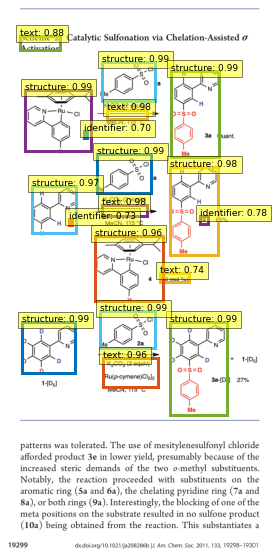

Image: ../../data/real-data/annotations/part1/val2017/ja9039289-Table-c3.png


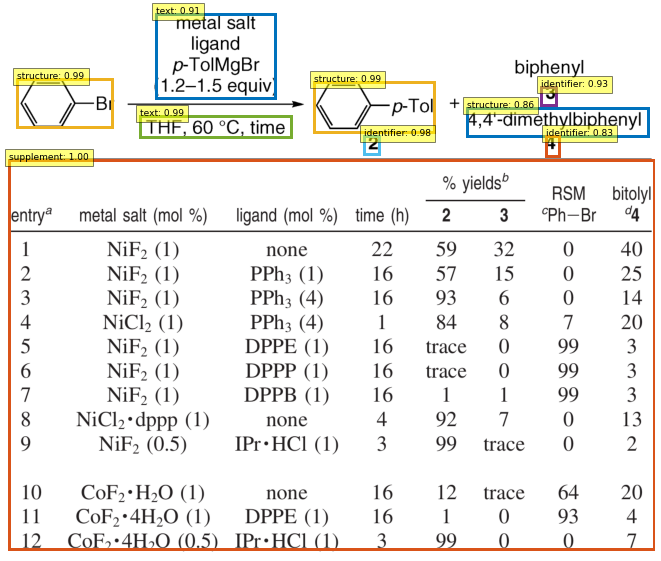

Image: ../../data/real-data/annotations/part1/val2017/ja511335v-Table-c1.png


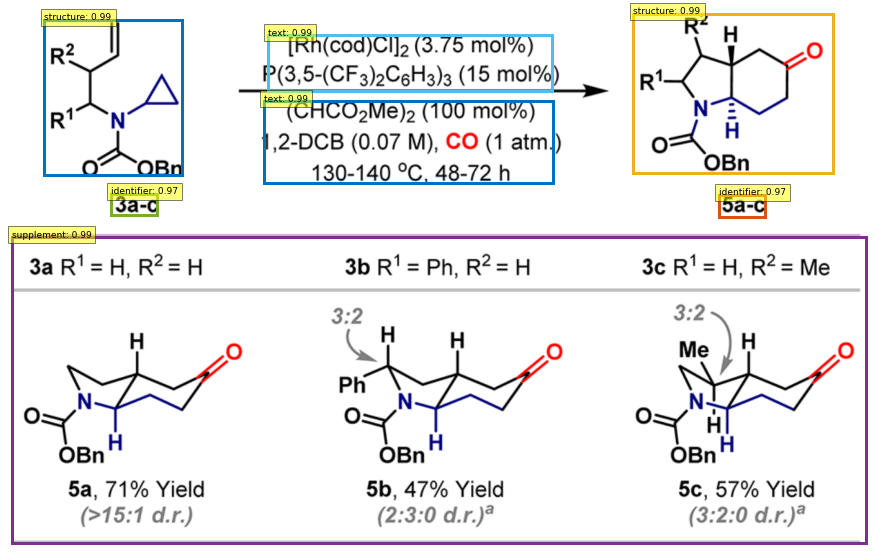

Image: ../../data/real-data/annotations/part1/val2017/ja406383h-Table-c1.png


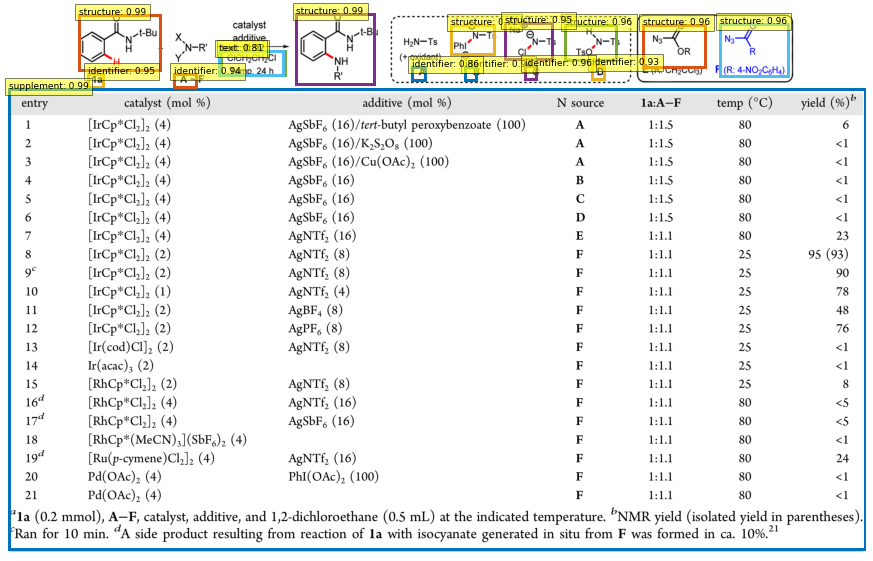

Image: ../../data/real-data/annotations/part1/val2017/ja408031s-Table-c1.png


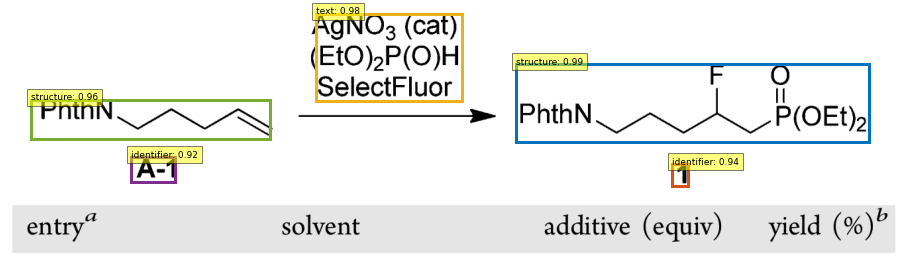

Image: ../../data/real-data/annotations/part1/val2017/ja0289088-Table-c1.png


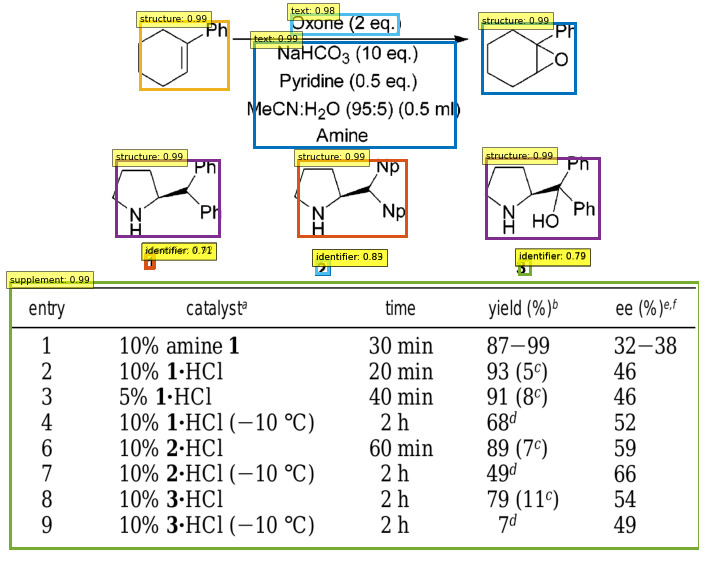

Image: ../../data/real-data/annotations/part1/val2017/ja200818w-Table-c1.png


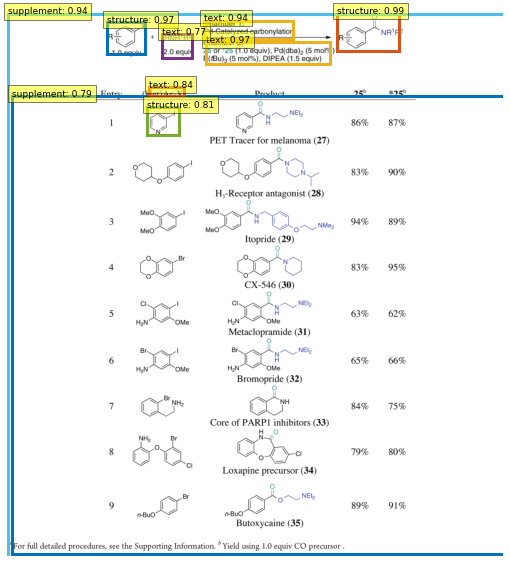

Image: ../../data/real-data/annotations/part1/val2017/ja511913h-Table-c1.png


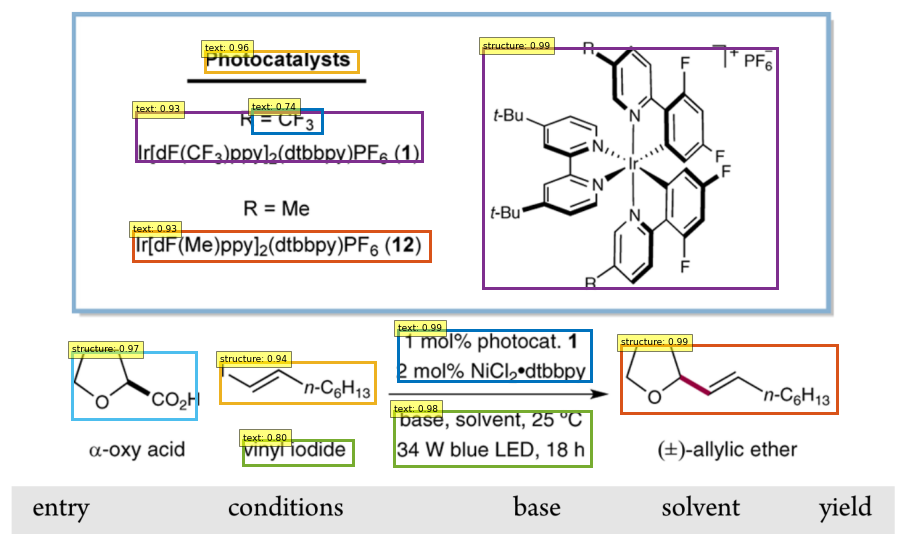

Image: ../../data/real-data/annotations/part1/val2017/ja208286b-Table-c1.png


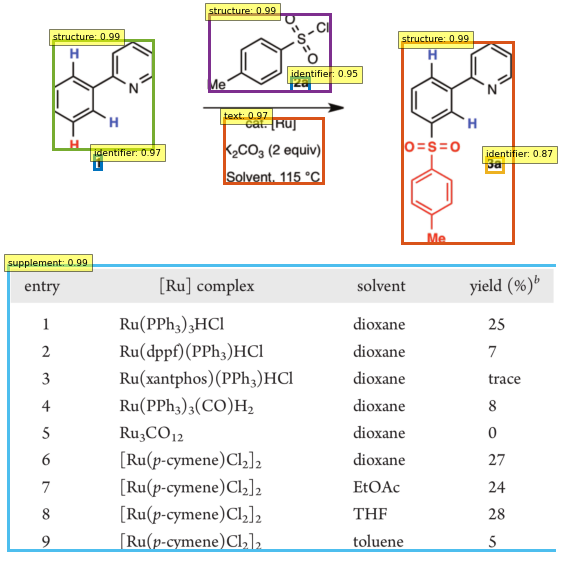

Image: ../../data/real-data/annotations/part1/val2017/ja3066978-Table-c1.png


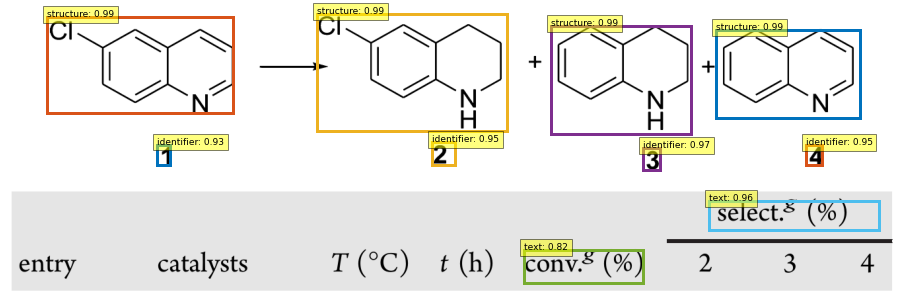

Image: ../../data/real-data/annotations/part1/val2017/ja9039289-Table-c2.png


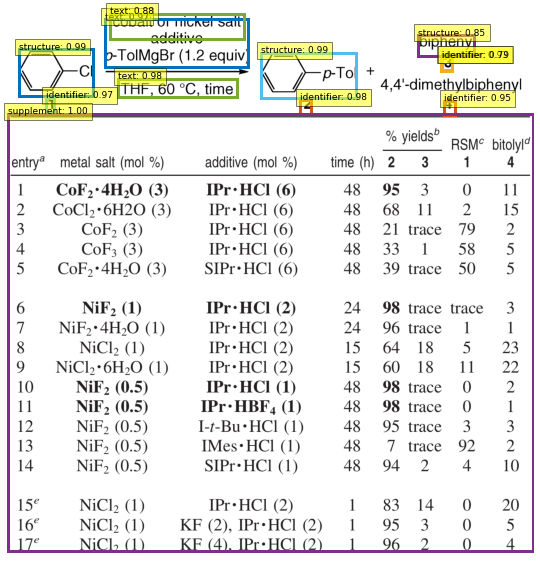

Image: ../../data/real-data/annotations/part1/val2017/ja406383h-Table-c2.png


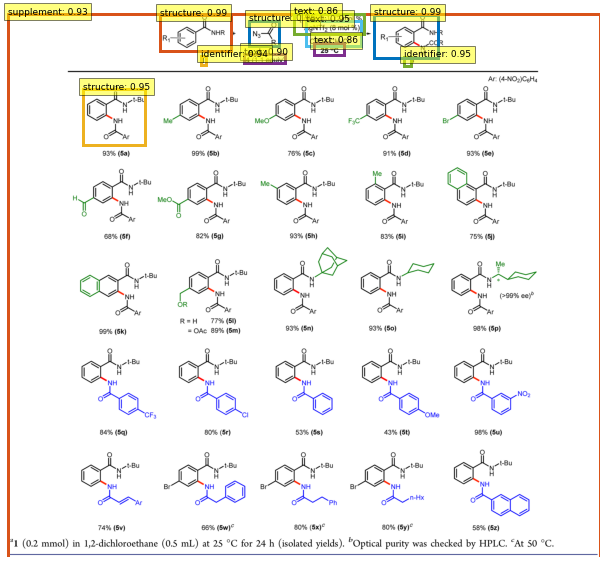

In [84]:
from PIL import Image
import os
from pycocotools.coco import COCO

# iterate over images in validation set and visualize model predictions

val_coco = COCO("../../data/real-data/annotations/part1/annotations/instances_val2017.json")
imgs = val_coco.imgs

for _, img_name in imgs.items():
    img_path = os.path.join('../../data/real-data/annotations/part1/val2017', img_name['file_name'])
    im = Image.open(img_path)
    print(f"Image: {img_path}")
    run_worflow(im, model)

loading annotations into memory...
Done (t=0.06s)
creating index...
index created!
Image: ../../data/real-data/annotations/part1/train2017/ja5080739-Table-c4.png


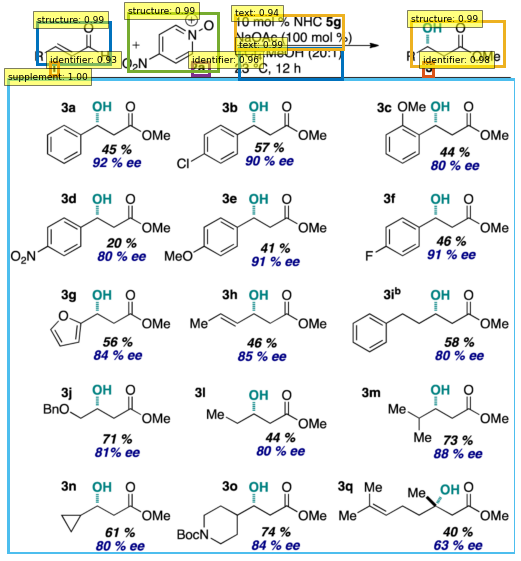

Image: ../../data/real-data/annotations/part1/train2017/ja9612413-Table-c2.png


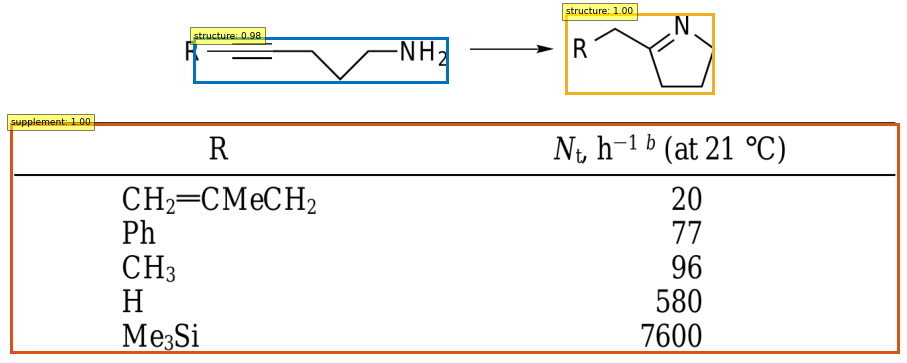

Image: ../../data/real-data/annotations/part1/train2017/ja012741l-Figure-c1.png


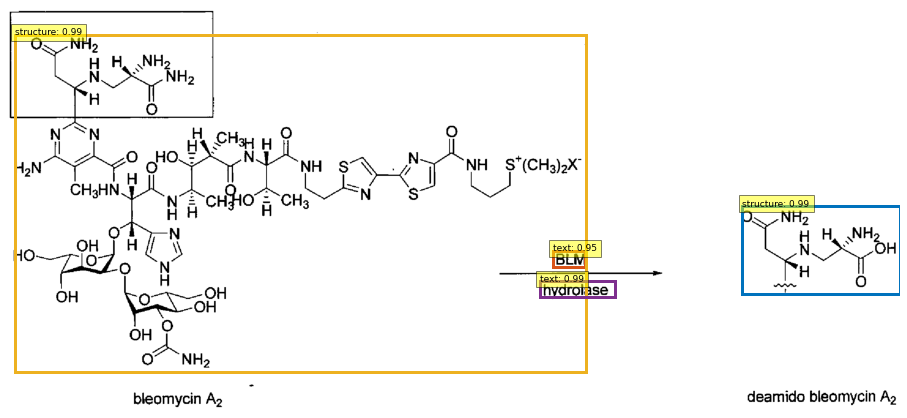

Image: ../../data/real-data/annotations/part1/train2017/ja011003u-Table-c2.png


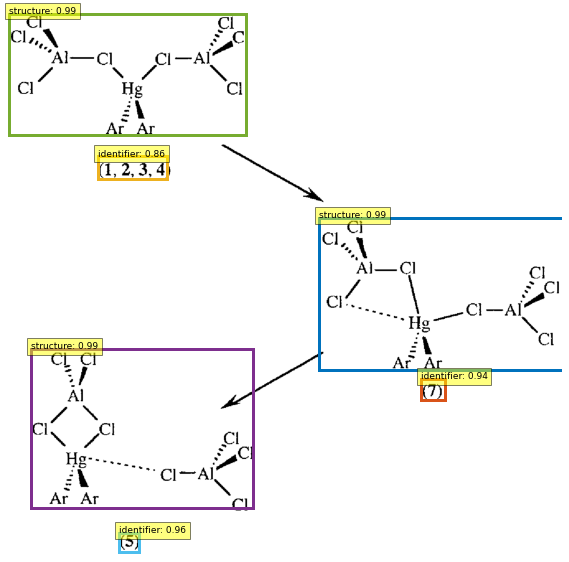

Image: ../../data/real-data/annotations/part1/train2017/ja075824w-Table-c2.png


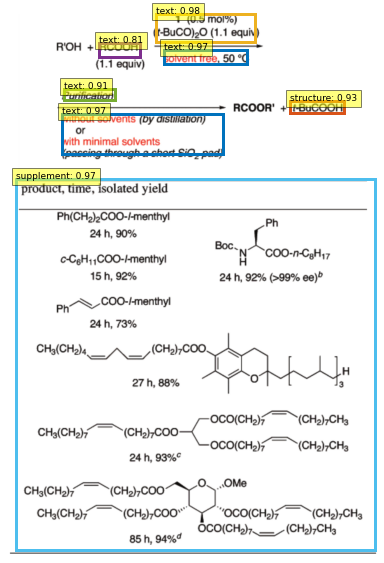

Image: ../../data/real-data/annotations/part1/train2017/ja9535975-Table-c1.png


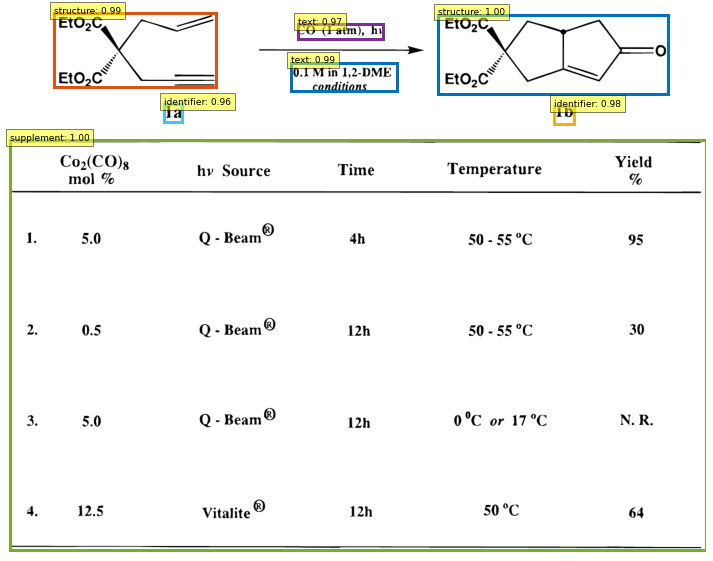

Image: ../../data/real-data/annotations/part1/train2017/ja2070522-Figure-c1.png


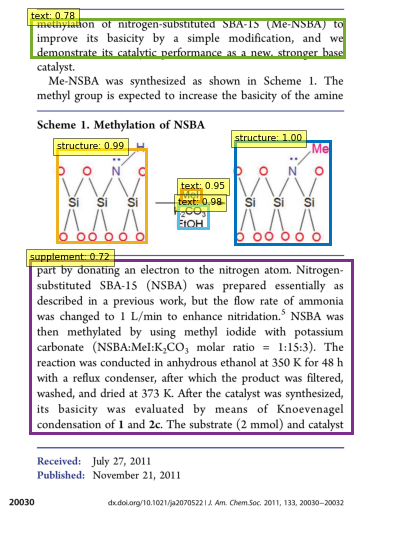

Image: ../../data/real-data/annotations/part1/train2017/ja001164i-Table-c2.png


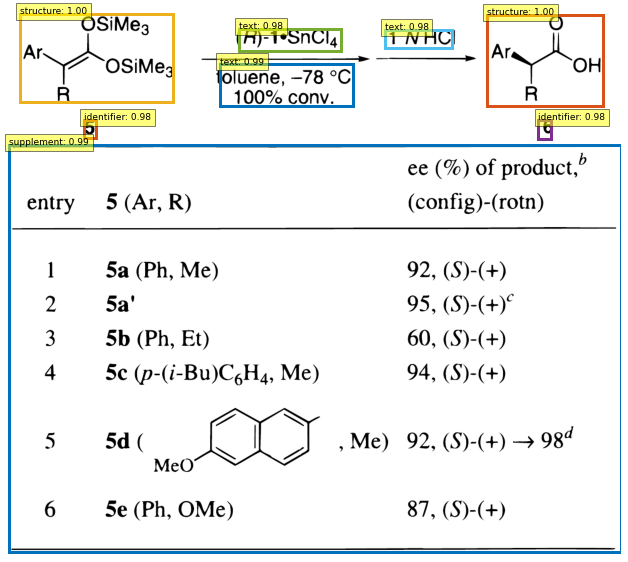

Image: ../../data/real-data/annotations/part1/train2017/ja010342k-Figure-c1.png


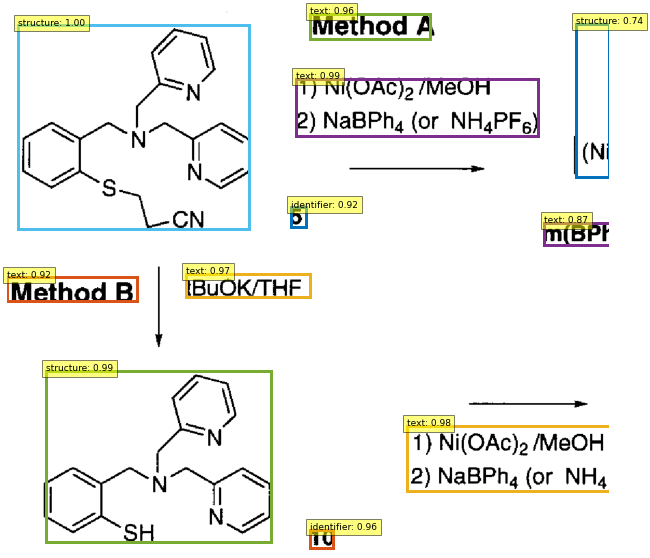

Image: ../../data/real-data/annotations/part1/train2017/ja806060a-Table-c1.png


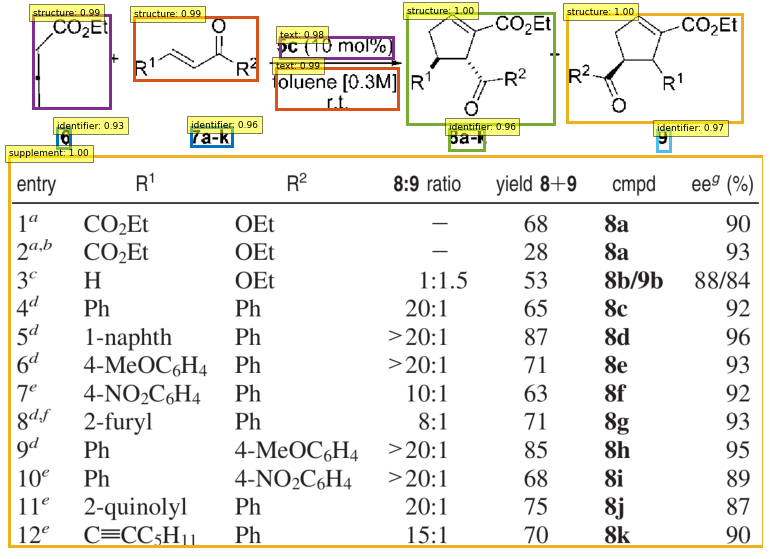

Image: ../../data/real-data/annotations/part1/train2017/ja0289088-Table-c3.png


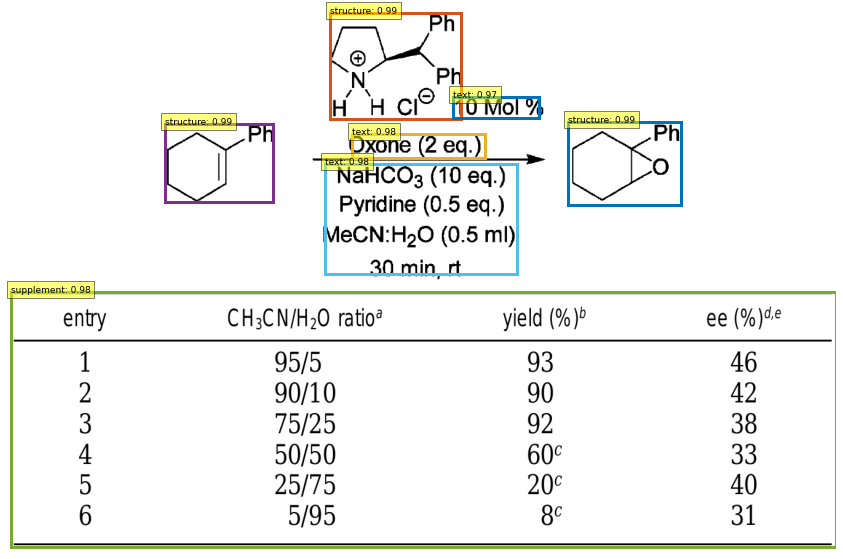

Image: ../../data/real-data/annotations/part1/train2017/ja063878k-Table-c2.png


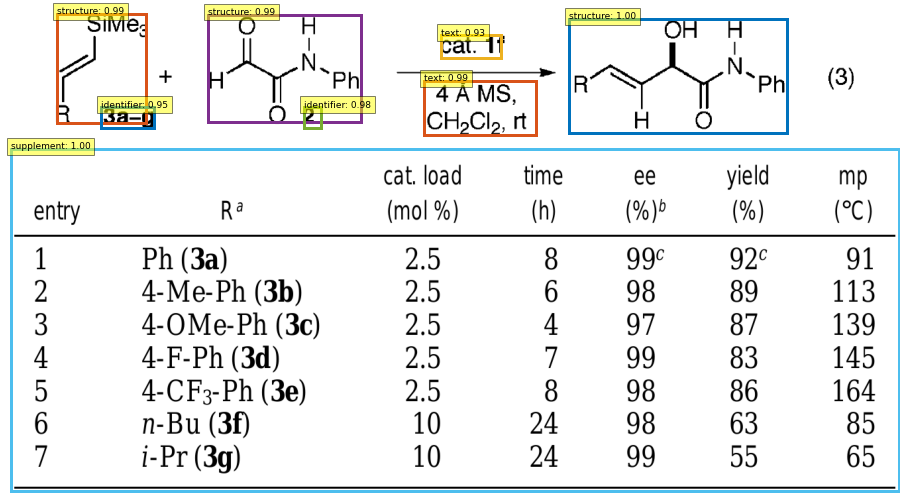

Image: ../../data/real-data/annotations/part1/train2017/ja5080739-Table-c1.png


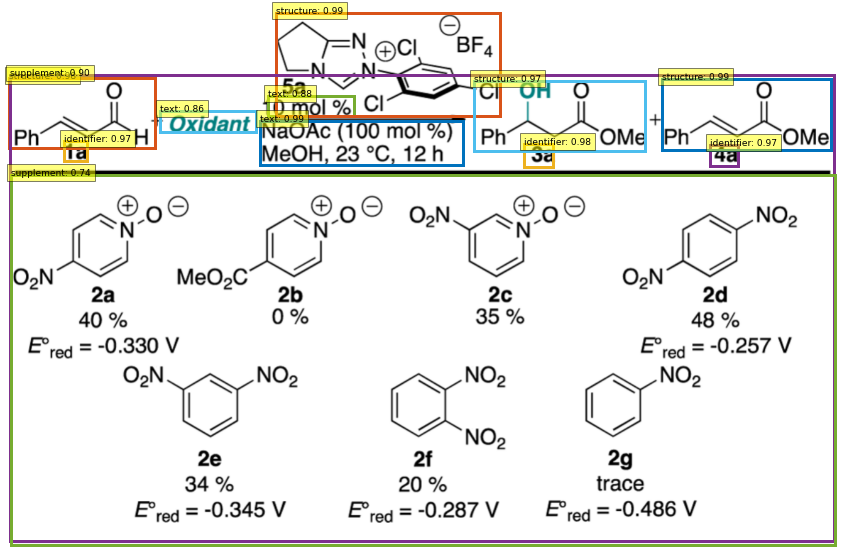

Image: ../../data/real-data/annotations/part1/train2017/ja905415r-Table-c4.png


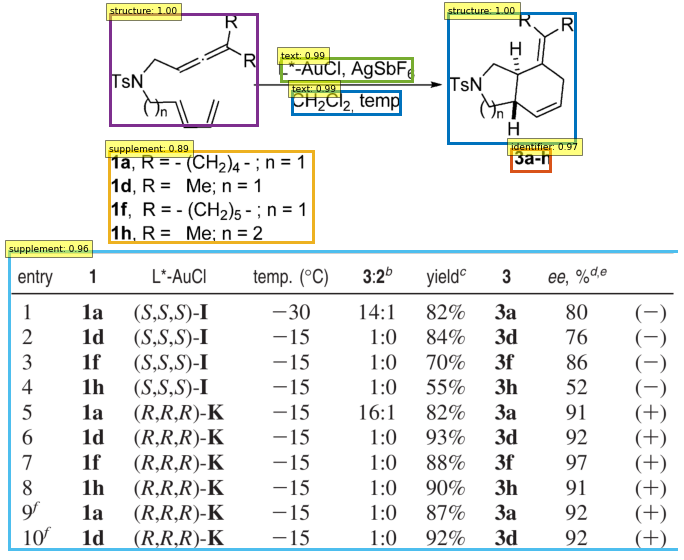

Image: ../../data/real-data/annotations/part1/train2017/jacs.6b01306-Table-c1.png


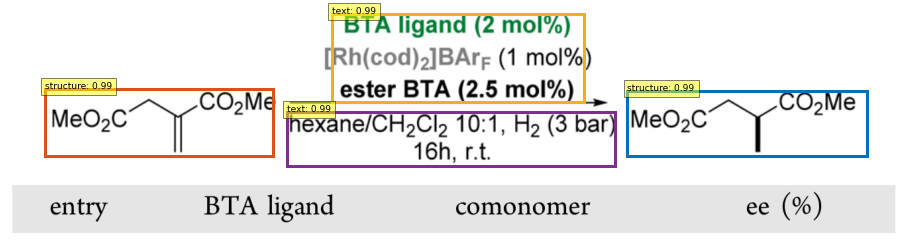

Image: ../../data/real-data/annotations/part1/train2017/ja5080739-Table-c2.png


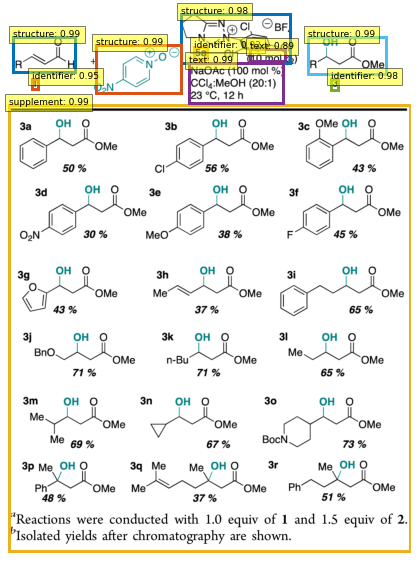

Image: ../../data/real-data/annotations/part1/train2017/ja407179c-Table-c1.png


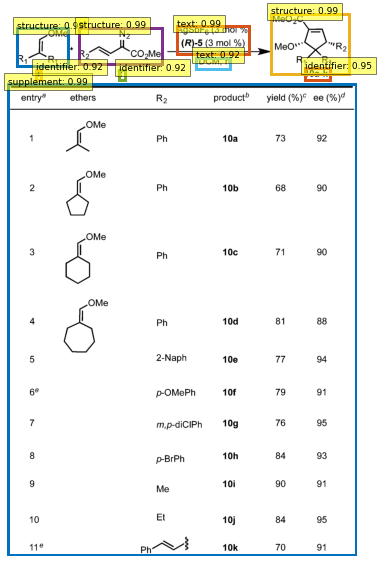

Image: ../../data/real-data/annotations/part1/train2017/ja054378e-Figure-c1.png


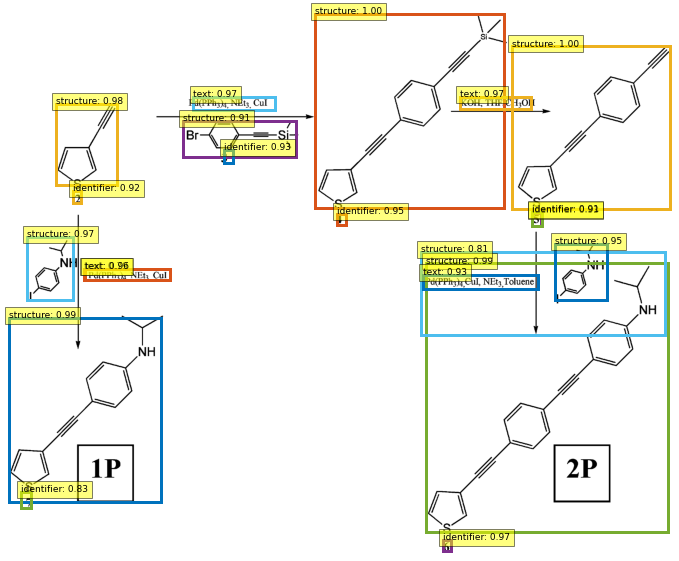

Image: ../../data/real-data/annotations/part1/train2017/ja001164i-Table-c5.png


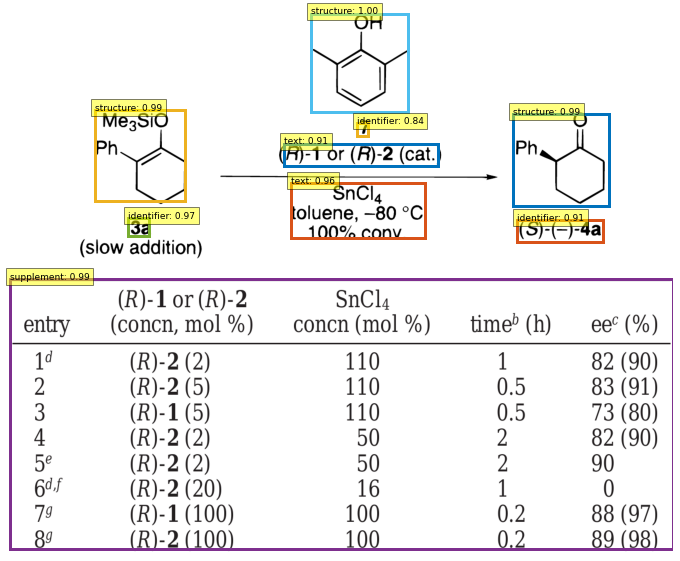

Image: ../../data/real-data/annotations/part1/train2017/ja026703t-Table-c3.png


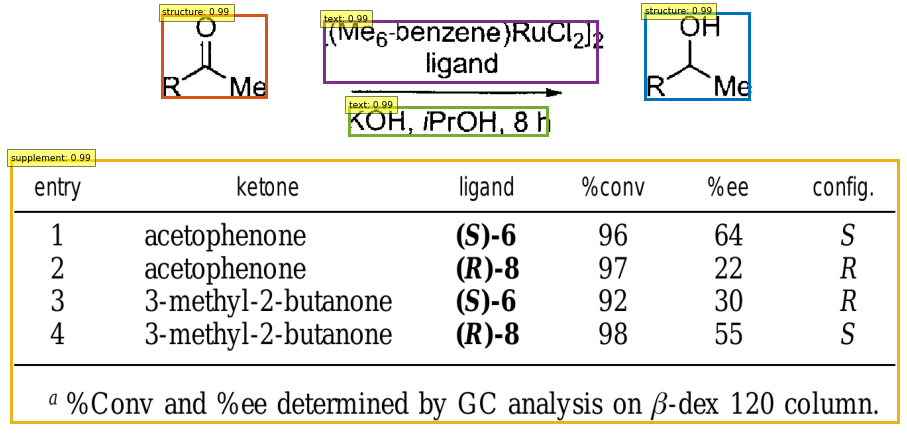

Image: ../../data/real-data/annotations/part1/train2017/ja0516864-Figure-c4.png


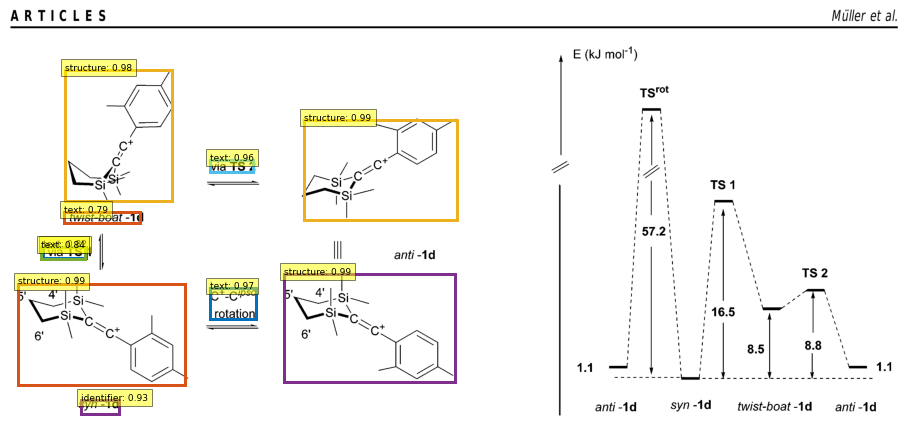

Image: ../../data/real-data/annotations/part1/train2017/ja0014685-Figure-c1.png


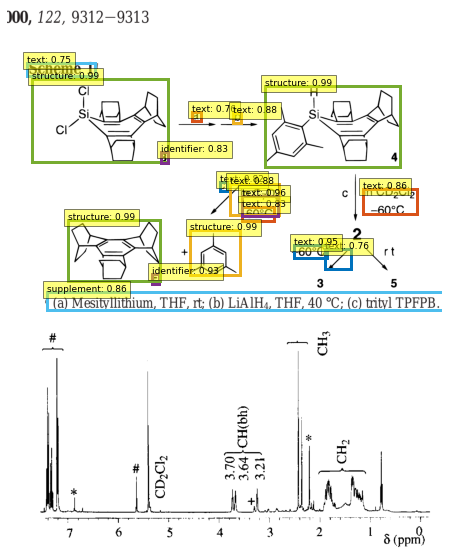

Image: ../../data/real-data/annotations/part1/train2017/ja1048847-Table-c1.png


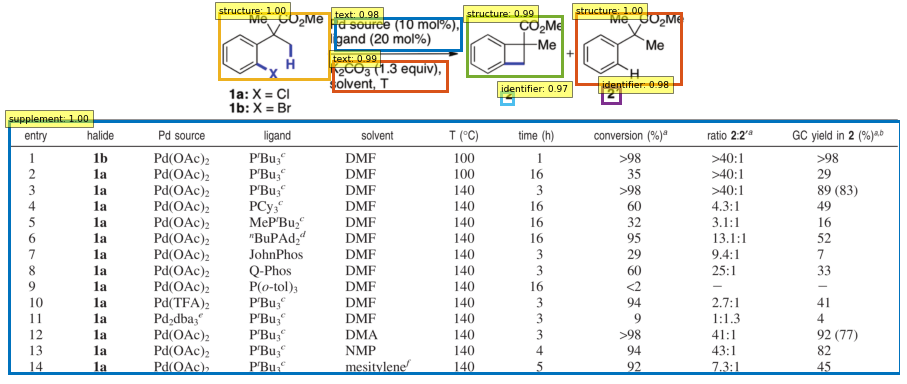

Image: ../../data/real-data/annotations/part1/train2017/ja312277g-Table-c1.png


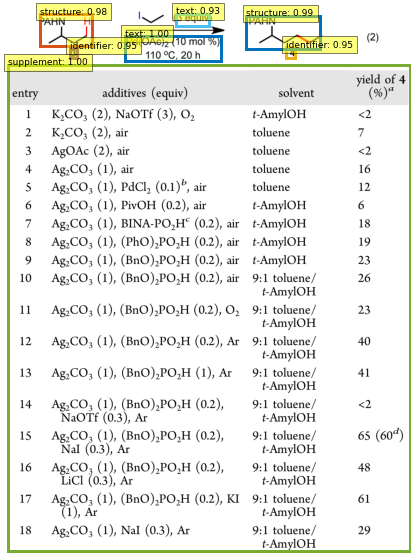

Image: ../../data/real-data/annotations/part1/train2017/ja206047h-Table-c1.png


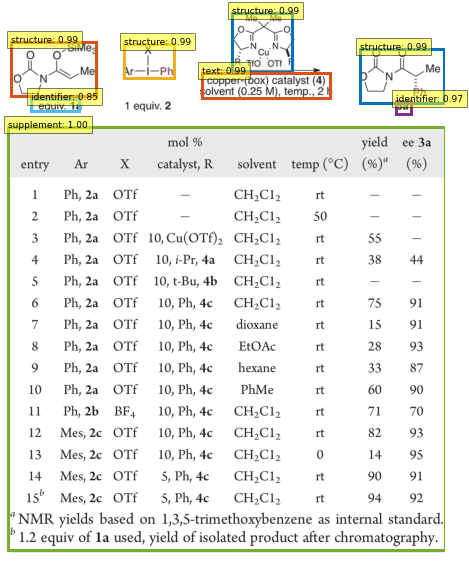

Image: ../../data/real-data/annotations/part1/train2017/ja001164i-Table-c8.png


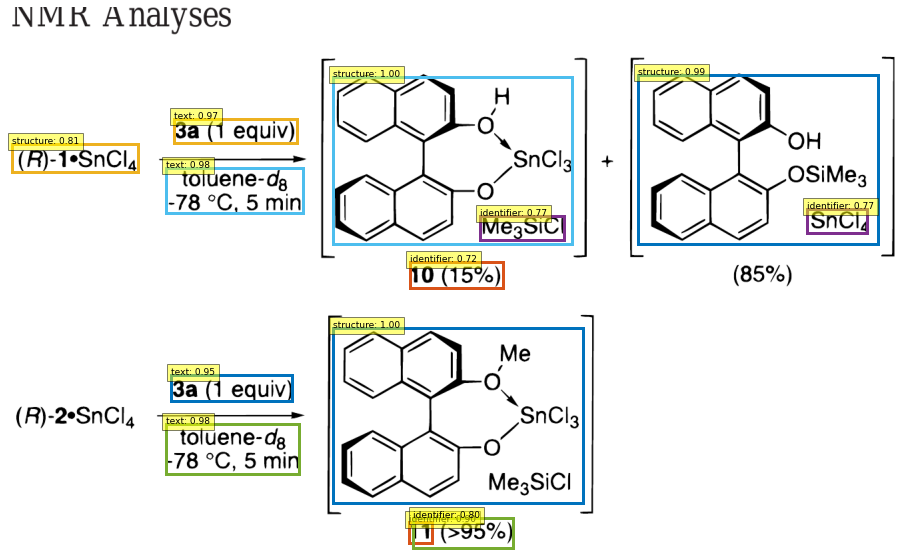

Image: ../../data/real-data/annotations/part1/train2017/ja2014746-Figure-c1.png


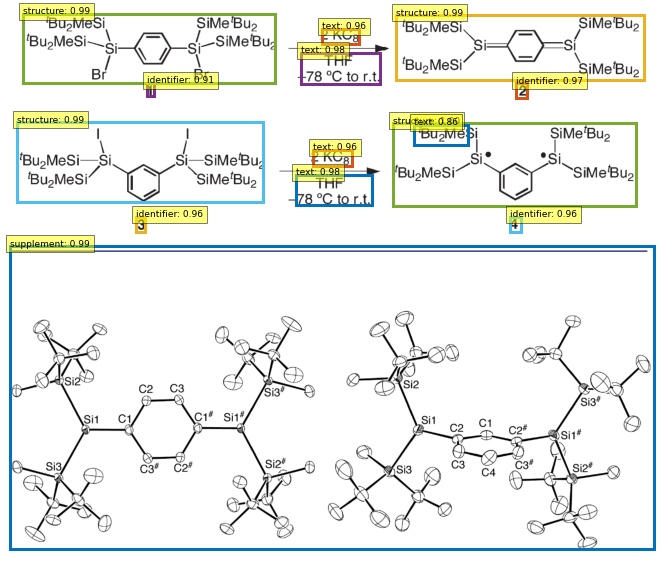

Image: ../../data/real-data/annotations/part1/train2017/ja406383h-Figure-c2.png


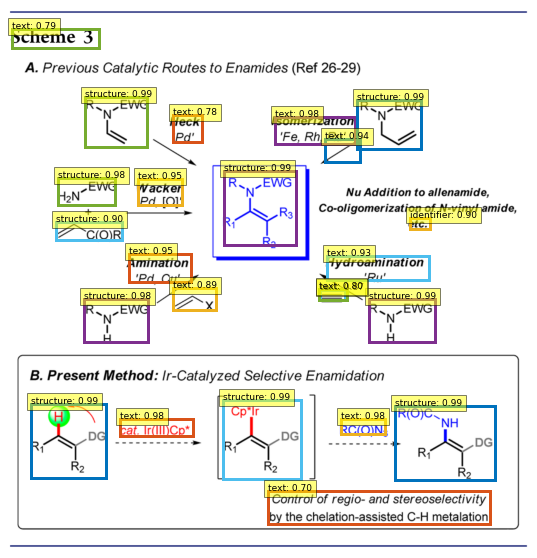

Image: ../../data/real-data/annotations/part1/train2017/ja402810t-Figure-c2.png


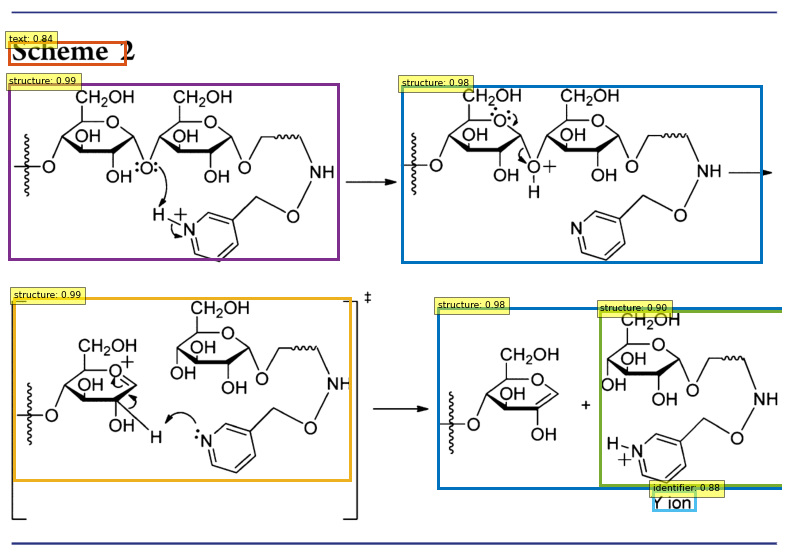

Image: ../../data/real-data/annotations/part1/train2017/ja0547477-Table-c1.png


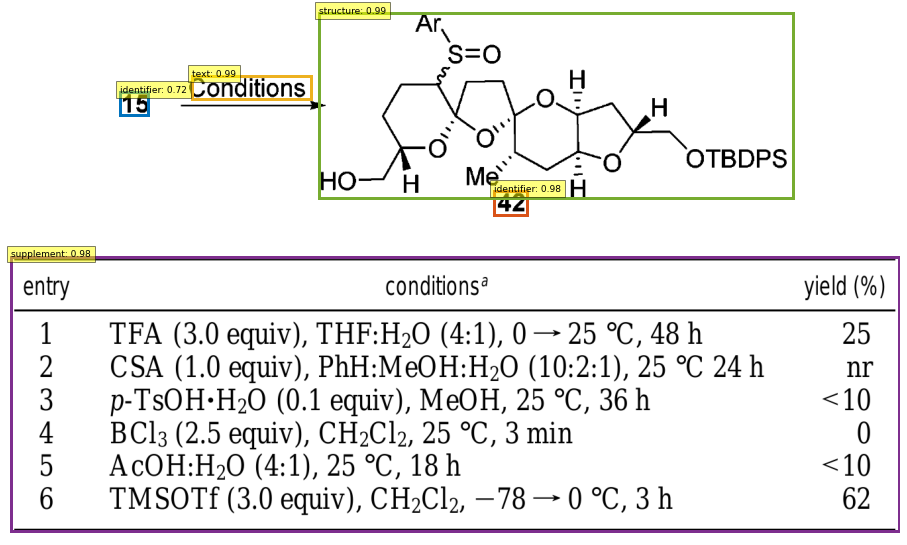

Image: ../../data/real-data/annotations/part1/train2017/ja407179c-Table-c2.png


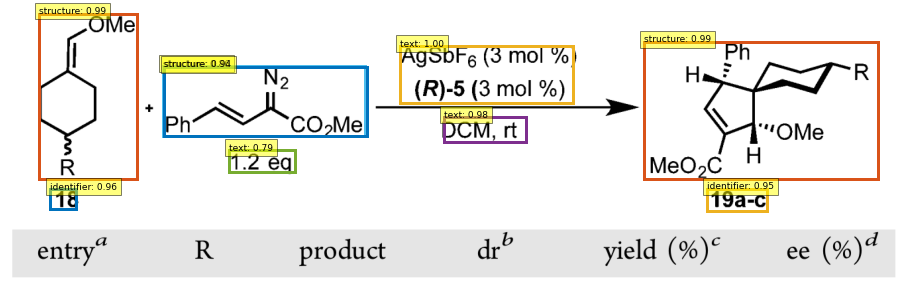

Image: ../../data/real-data/annotations/part1/train2017/jacs.5b05415-Figure-c4.png


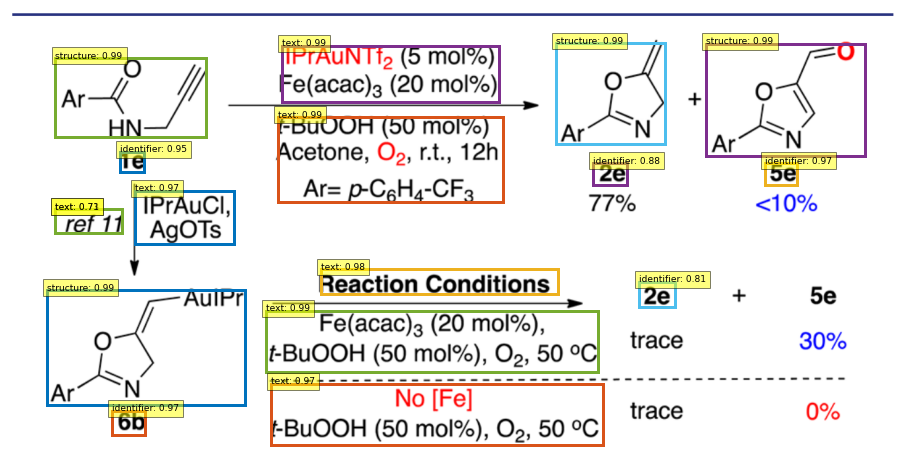

Image: ../../data/real-data/annotations/part1/train2017/ja9039289-Table-c10.png


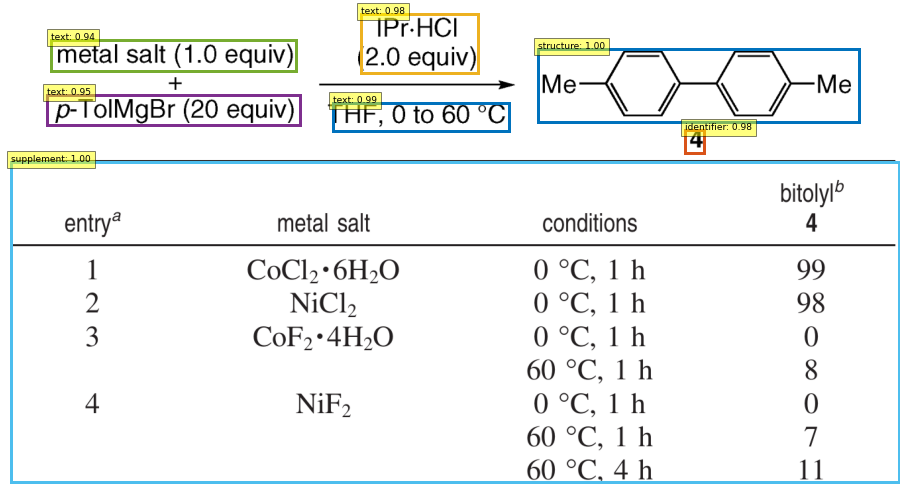

Image: ../../data/real-data/annotations/part1/train2017/ja300396h-Figure-c4.png


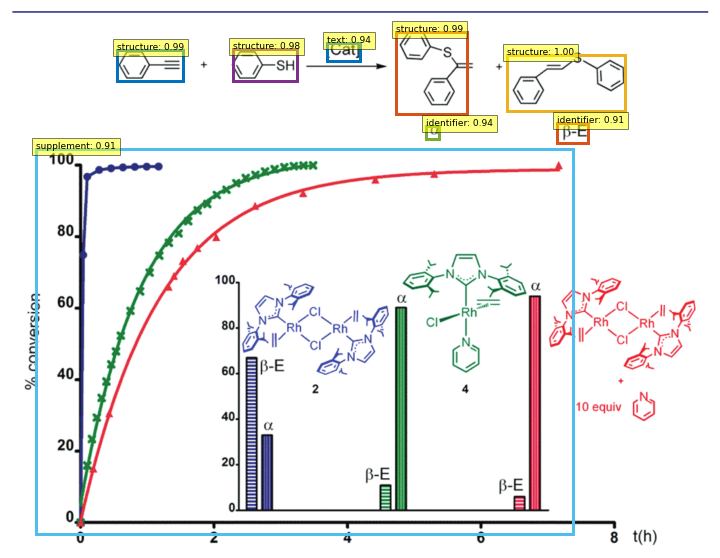

Image: ../../data/real-data/annotations/part1/train2017/ja063878k-Table-c1.png


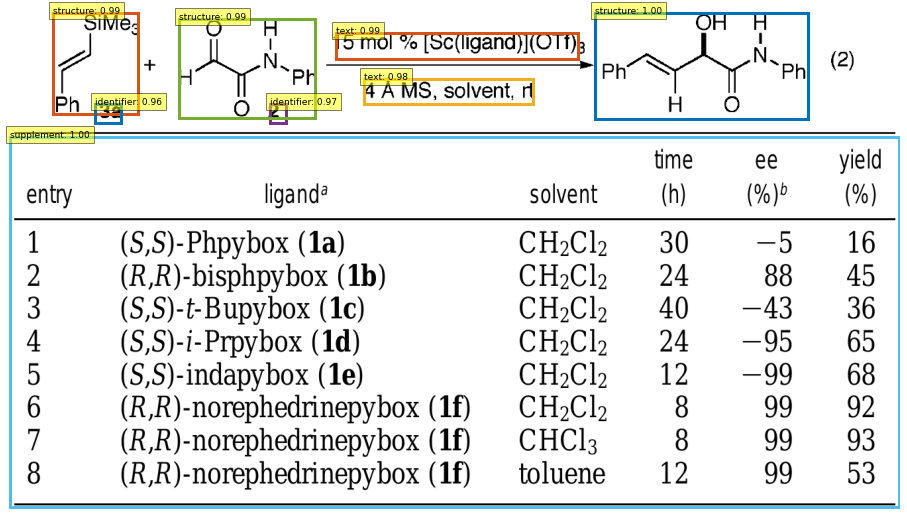

Image: ../../data/real-data/annotations/part1/train2017/ja053650h-Table-c2.png


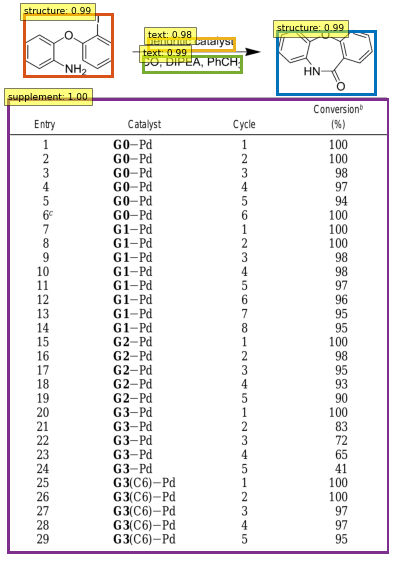

Image: ../../data/real-data/annotations/part1/train2017/ja001164i-Table-c1.png


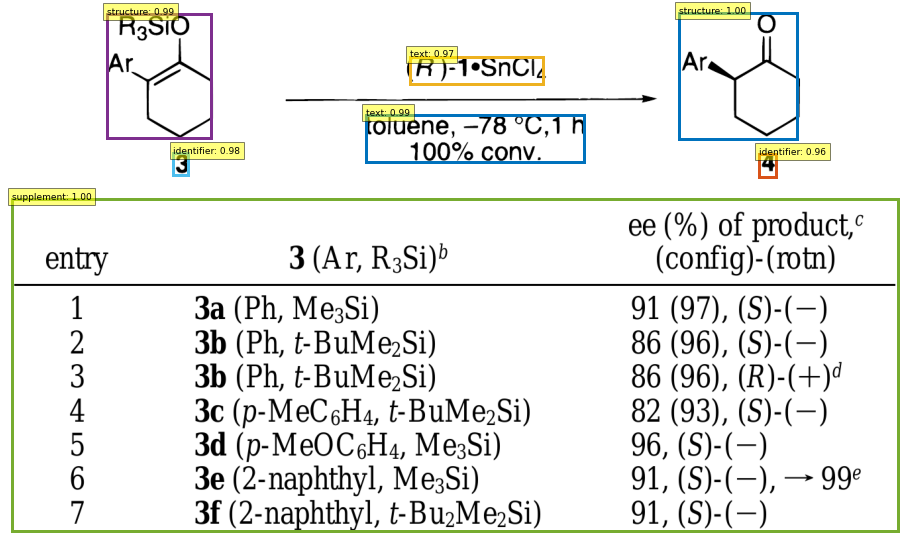

Image: ../../data/real-data/annotations/part1/train2017/ja0547477-Table-c2.png


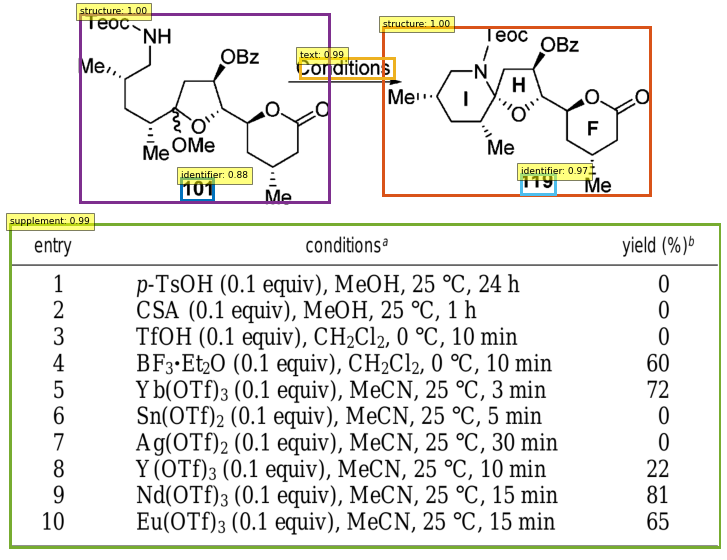

Image: ../../data/real-data/annotations/part1/train2017/ja406383h-Table-c3.png


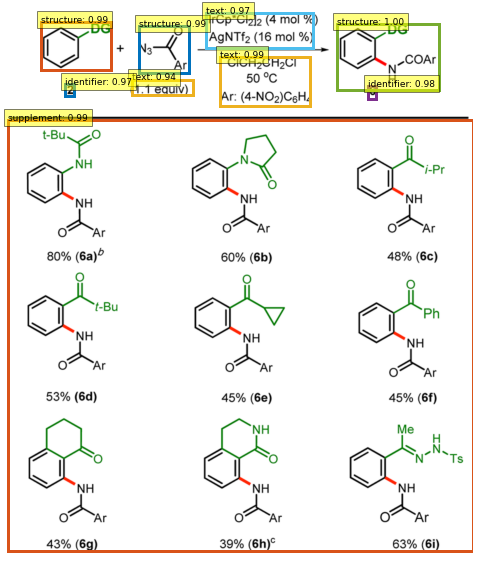

Image: ../../data/real-data/annotations/part1/train2017/ja5080739-Table-c3.png


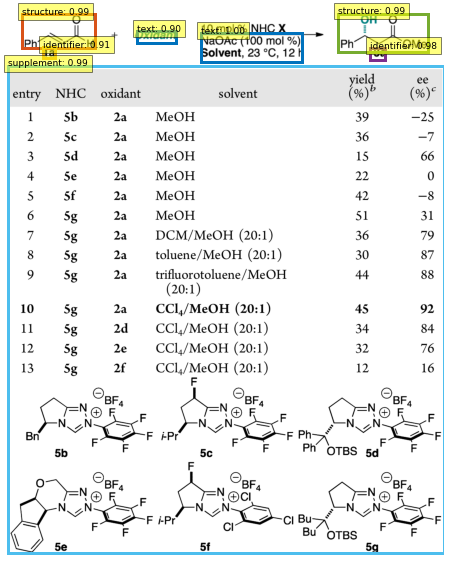

Image: ../../data/real-data/annotations/part1/train2017/ja063878k-Table-c3.png


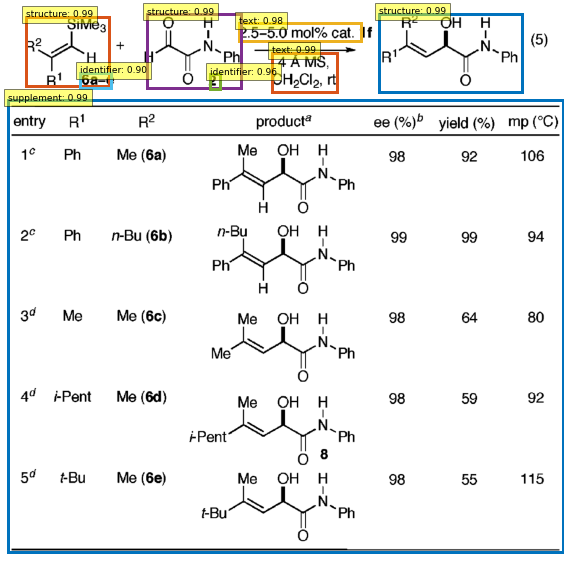

Image: ../../data/real-data/annotations/part1/train2017/ja001164i-Table-c6.png


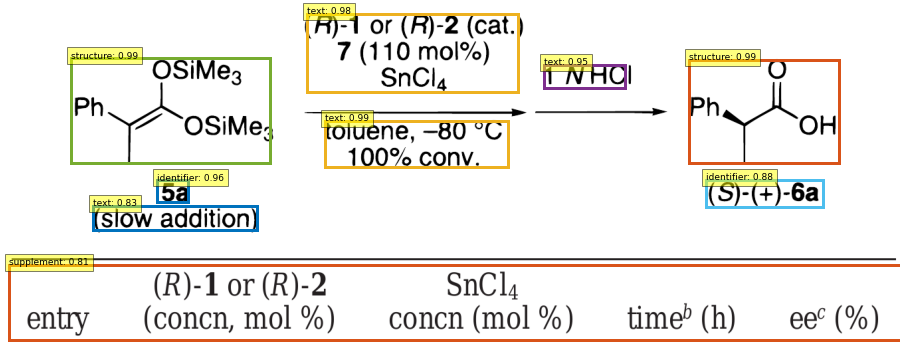

Image: ../../data/real-data/annotations/part1/train2017/jacs.5b05415-Figure-c1.png


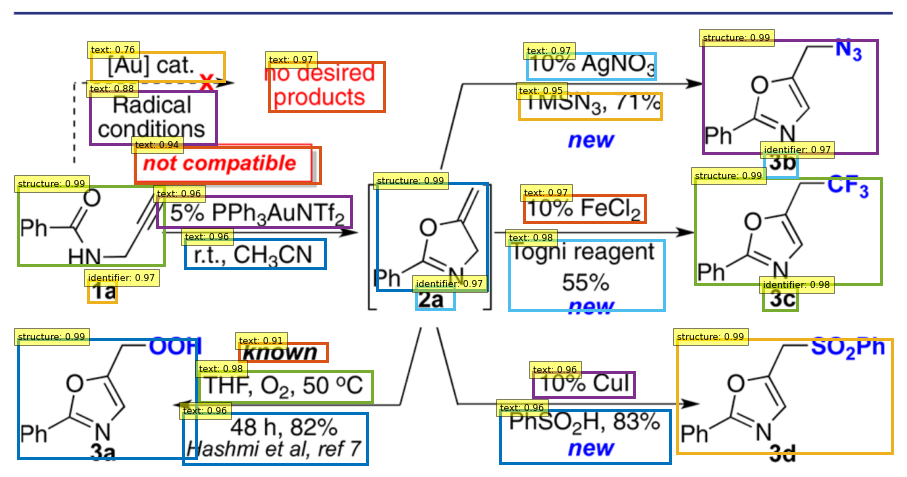

Image: ../../data/real-data/annotations/part1/train2017/ja406383h-Table-c4.png


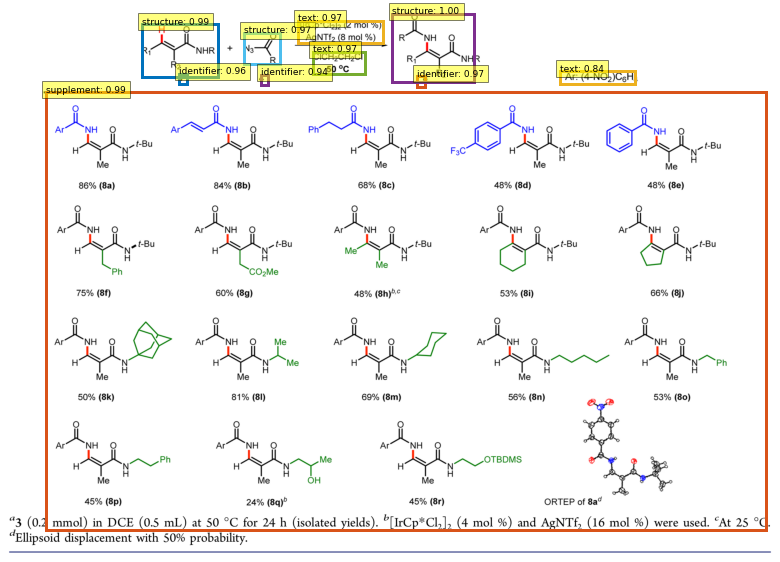

Image: ../../data/real-data/annotations/part1/train2017/ja0516864-Table-c1.png


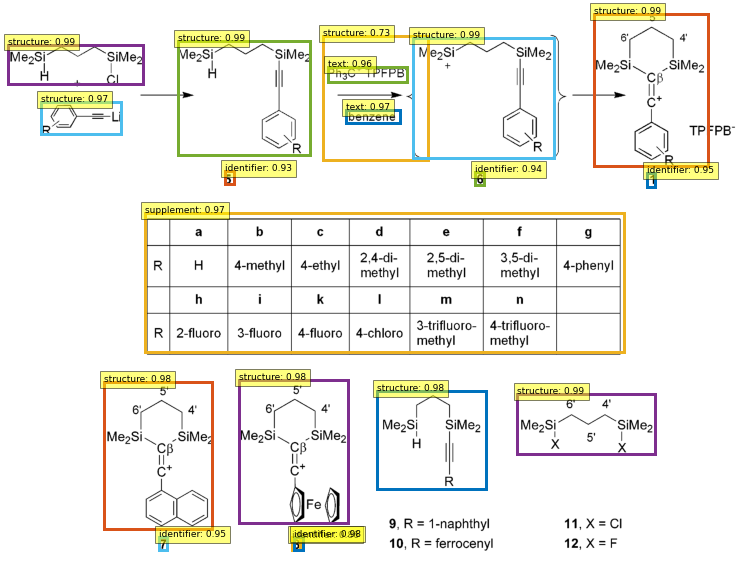

Image: ../../data/real-data/annotations/part1/train2017/ja408733f-Figure-c2.png


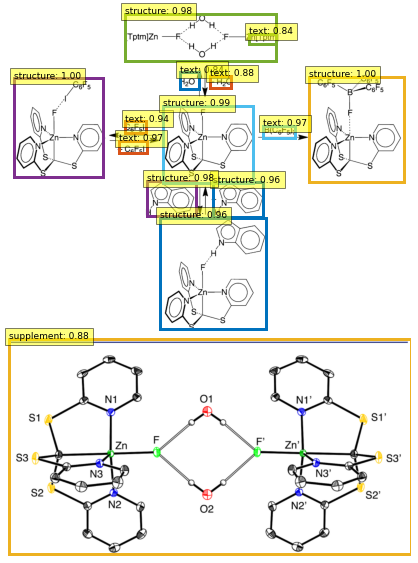

Image: ../../data/real-data/annotations/part1/train2017/ja410533y-Table-c1.png


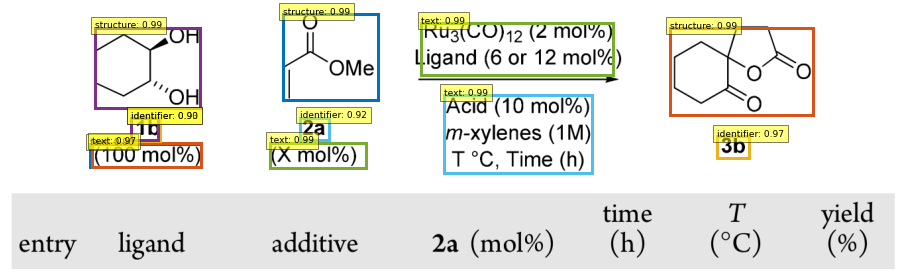

Image: ../../data/real-data/annotations/part1/train2017/ja980022+-Table-c1.png


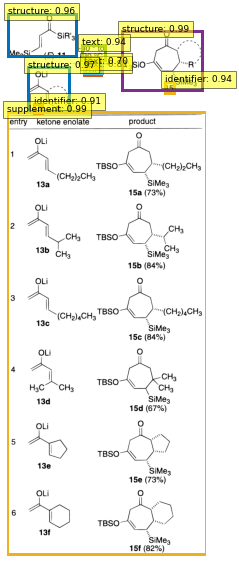

Image: ../../data/real-data/annotations/part1/train2017/jacs.5b11315-Figure-c4.png


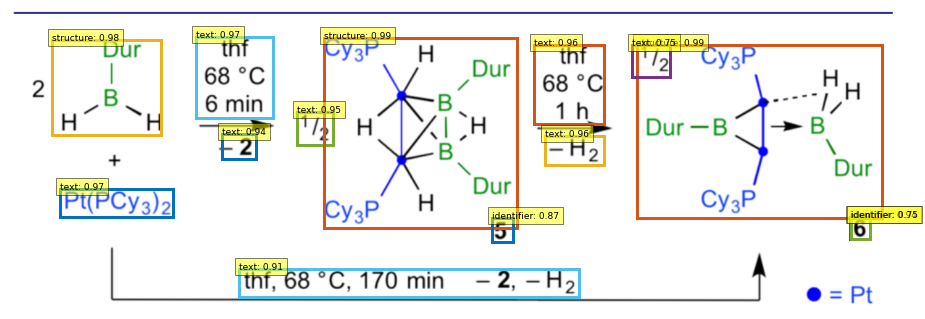

Image: ../../data/real-data/annotations/part1/train2017/ja075824w-Figure-c1.png


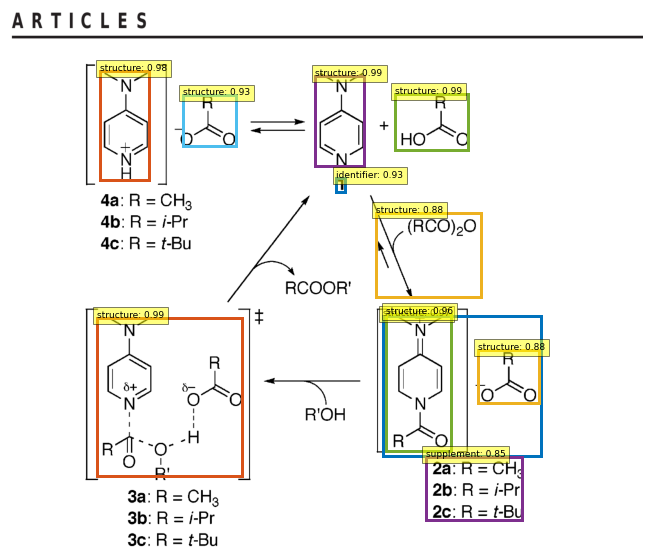

Image: ../../data/real-data/annotations/part1/train2017/ja106807u-Table-c1.png


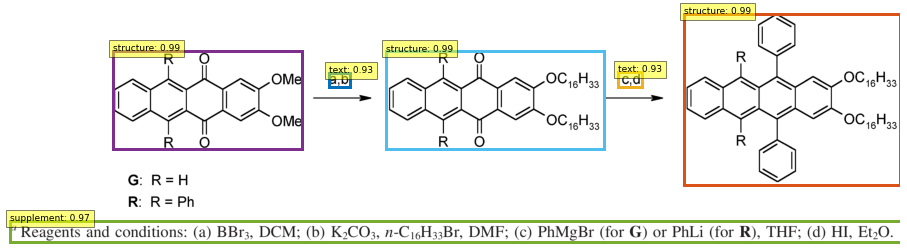

Image: ../../data/real-data/annotations/part1/train2017/ja806814c-Table-c1.png


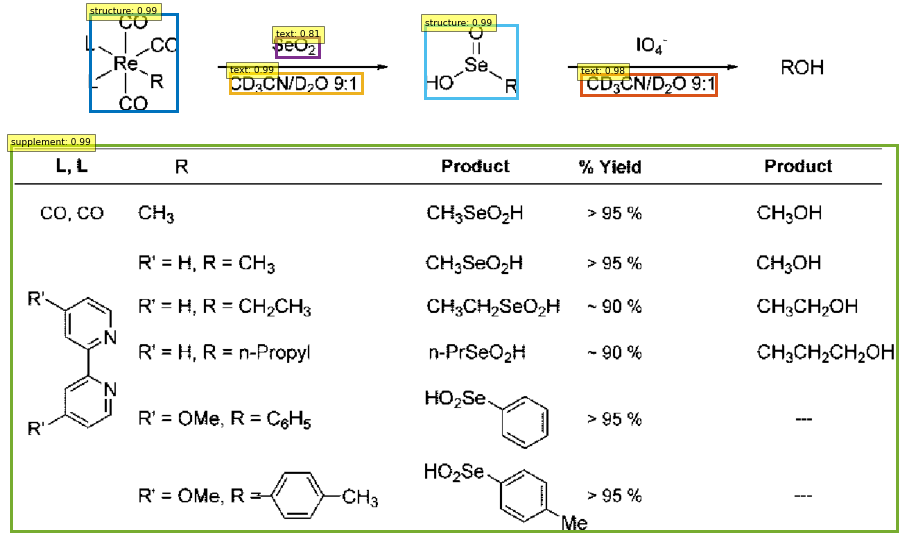

Image: ../../data/real-data/annotations/part1/train2017/ja075824w-Figure-c3.png


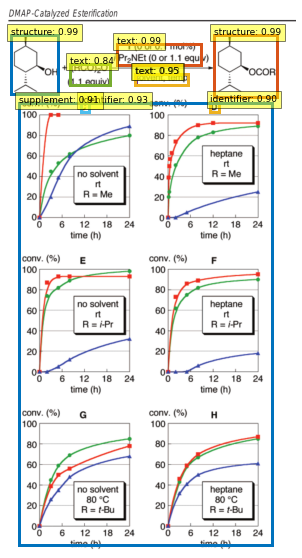

Image: ../../data/real-data/annotations/part1/train2017/jacs.5b05792-Table-c1.png


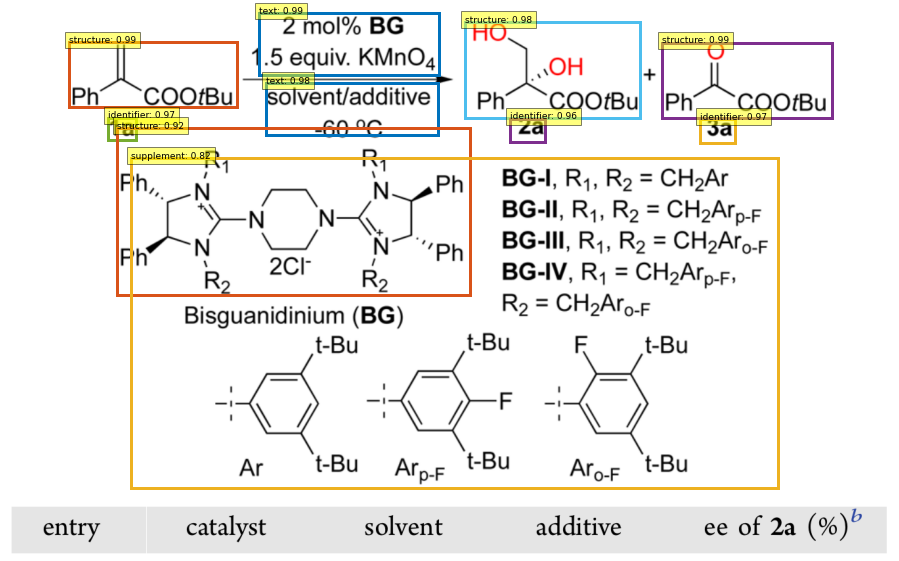

Image: ../../data/real-data/annotations/part1/train2017/ja511335v-Table-c3.png


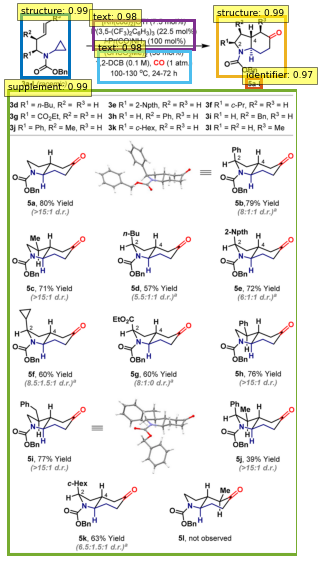

Image: ../../data/real-data/annotations/part1/train2017/jacs.5b12989-Table-c3.png


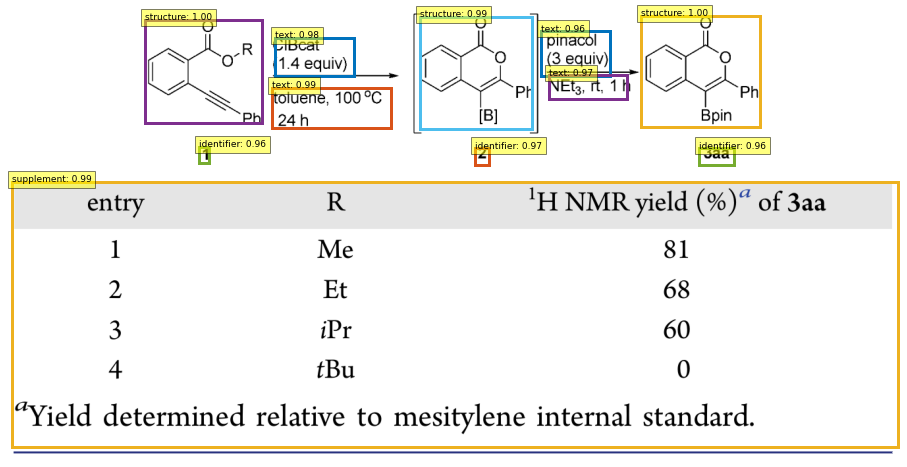

Image: ../../data/real-data/annotations/part1/train2017/ja9810742-Table-c3.png


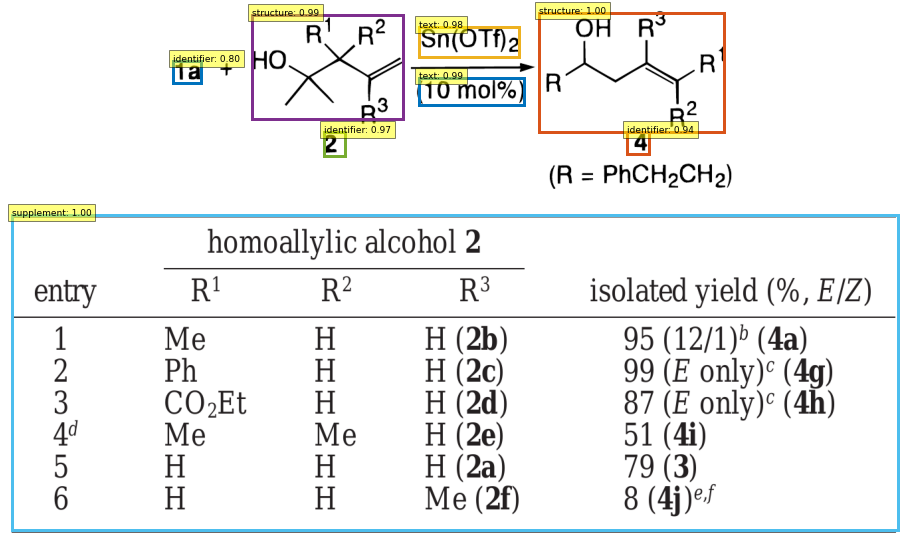

Image: ../../data/real-data/annotations/part1/train2017/jacs.5b05415-Figure-c6.png


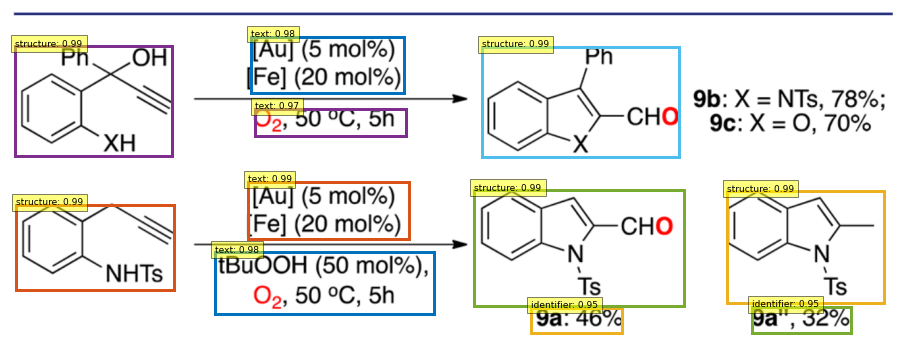

Image: ../../data/real-data/annotations/part1/train2017/ja410533y-Table-c5.png


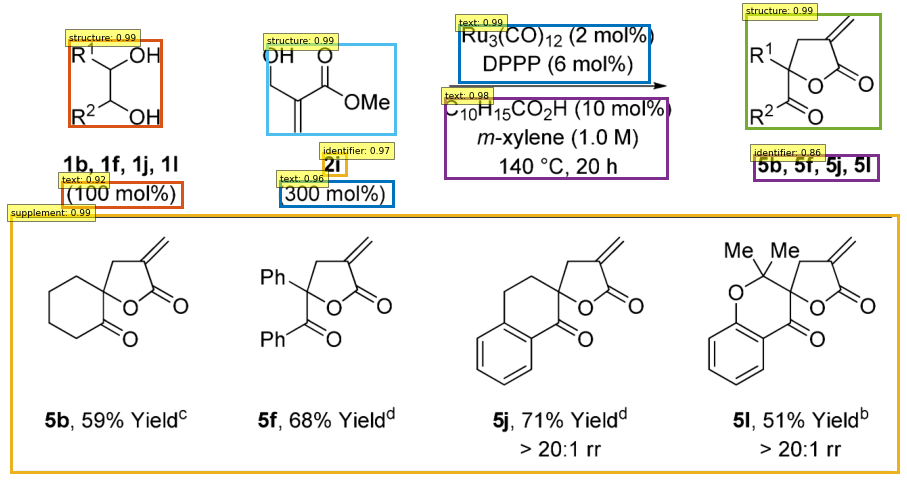

Image: ../../data/real-data/annotations/part1/train2017/ja074044k-Table-c1.png


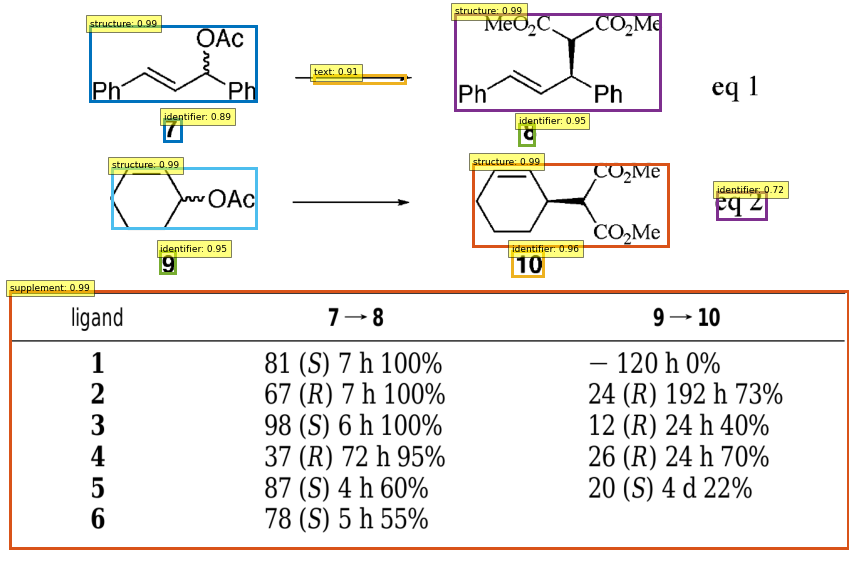

Image: ../../data/real-data/annotations/part1/train2017/ja410533y-Table-c4.png


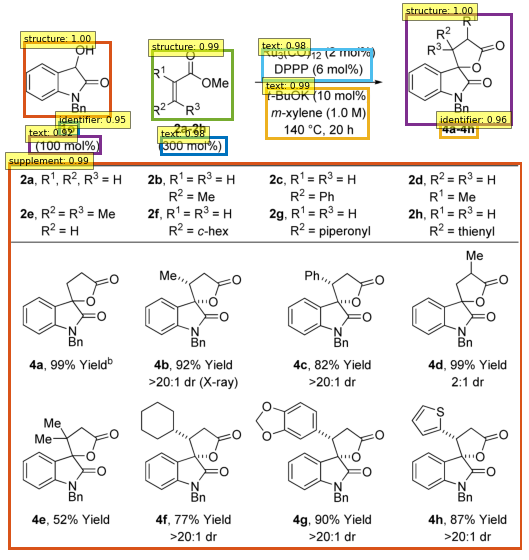

Image: ../../data/real-data/annotations/part1/train2017/ja030125e-Figure-c4.png


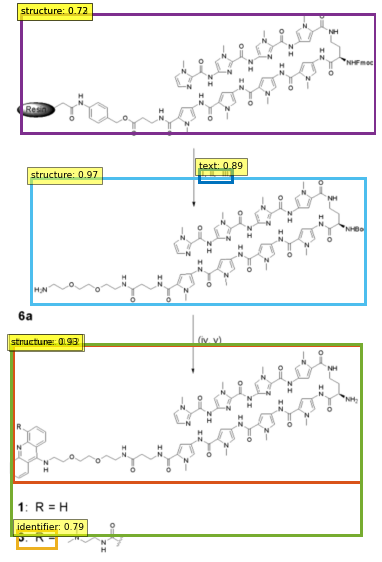

Image: ../../data/real-data/annotations/part1/train2017/ja026640e-Table-c1.png


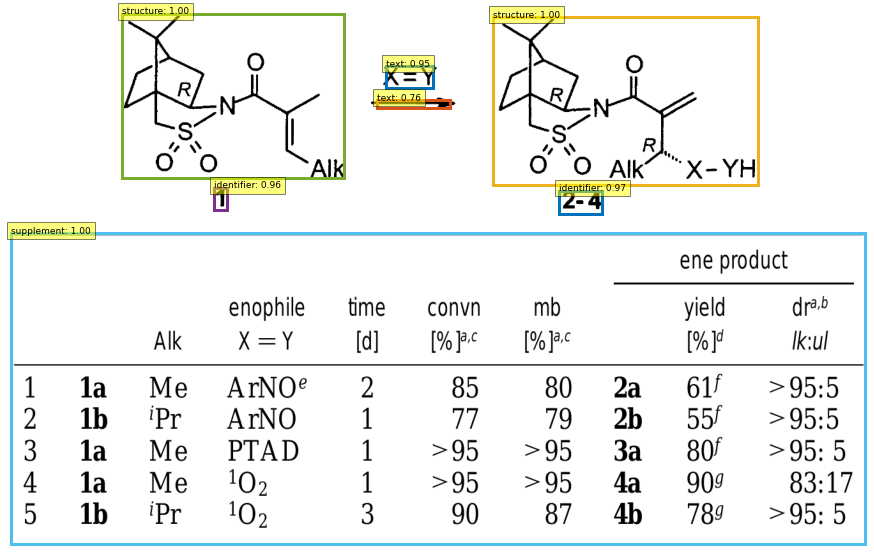

Image: ../../data/real-data/annotations/part1/train2017/ja312277g-Table-c2.png


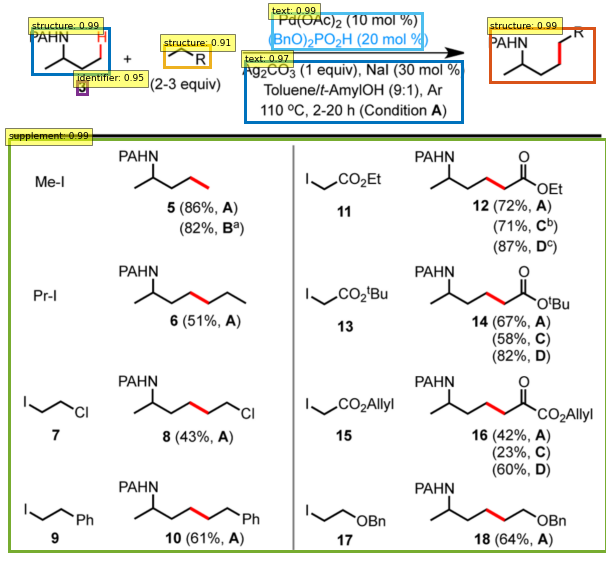

Image: ../../data/real-data/annotations/part1/train2017/ja407689a-Table-c1.png


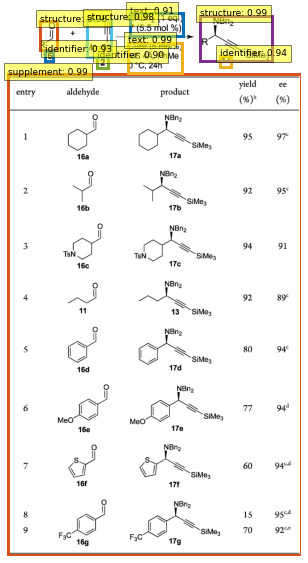

Image: ../../data/real-data/annotations/part1/train2017/ja075824w-Figure-c2.png


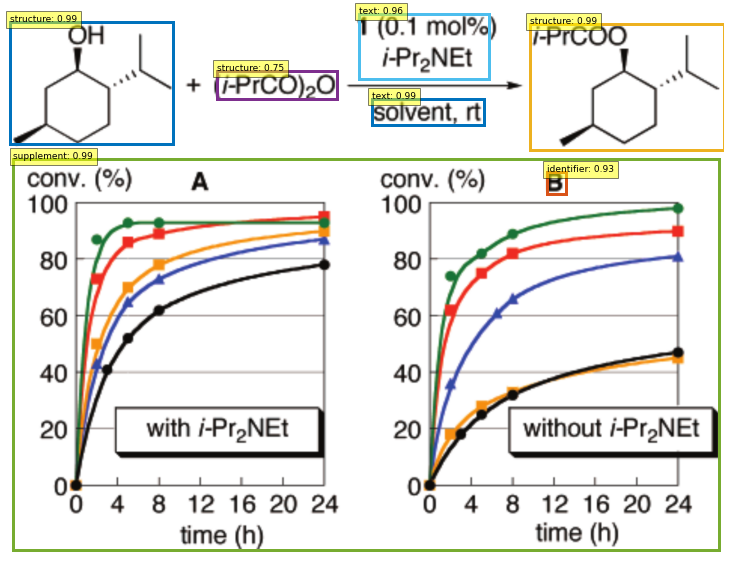

Image: ../../data/real-data/annotations/part1/train2017/ja053368a-Table-c3.png


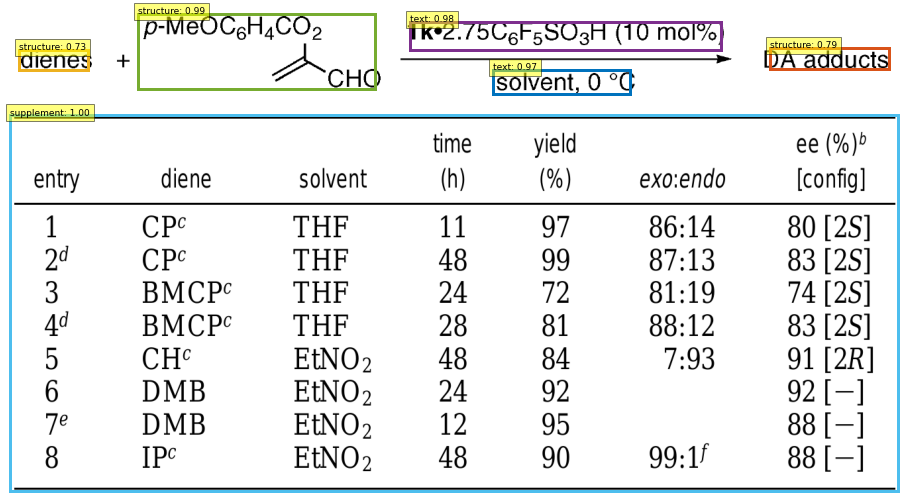

Image: ../../data/real-data/annotations/part1/train2017/jacs.5b12989-Table-c1.png


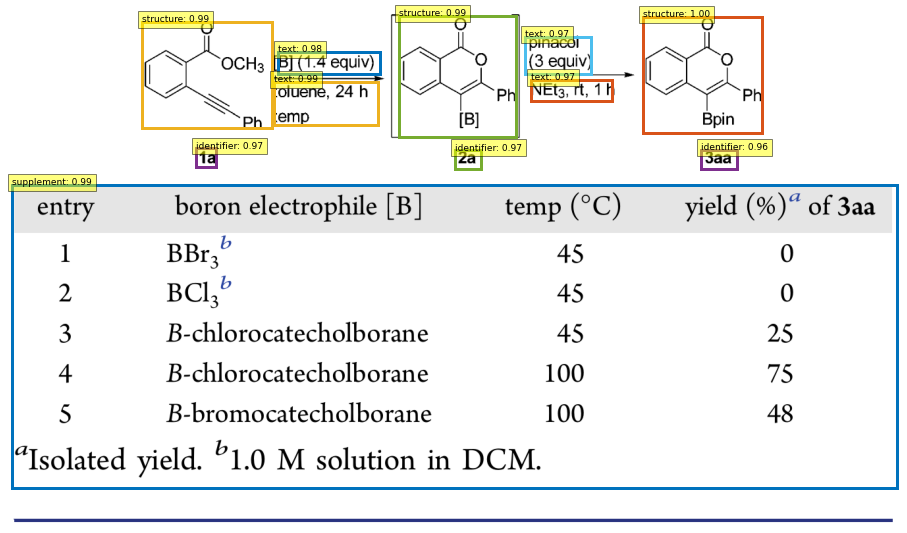

Image: ../../data/real-data/annotations/part1/train2017/ja312277g-Table-c3.png


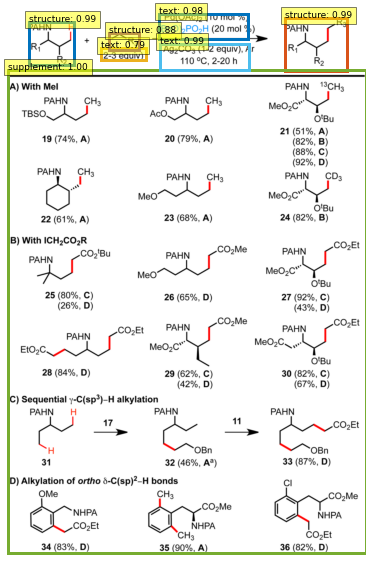

Image: ../../data/real-data/annotations/part1/train2017/ja001164i-Table-c4.png


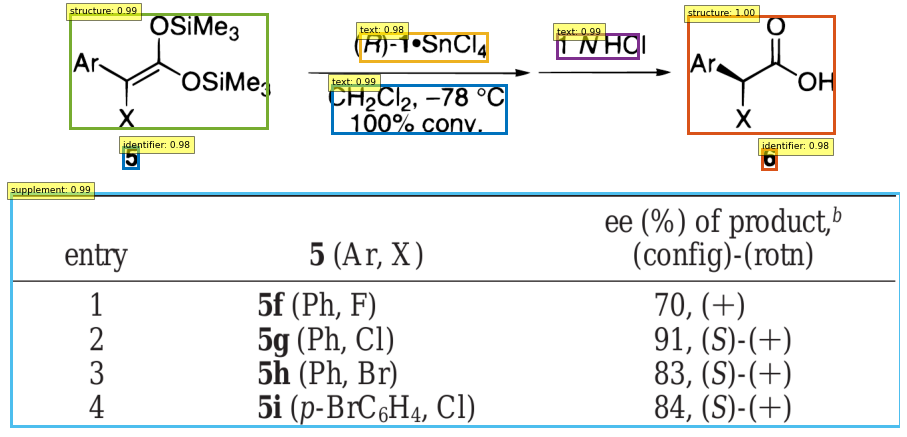

Image: ../../data/real-data/annotations/part1/train2017/ja053650h-Table-c1.png


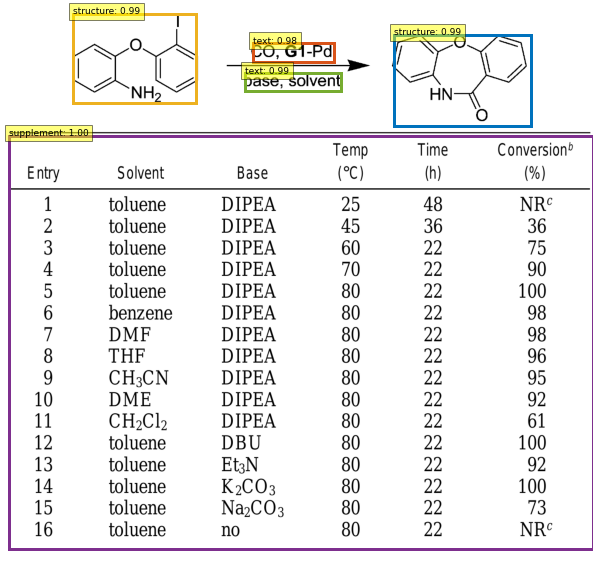

Image: ../../data/real-data/annotations/part1/train2017/ja905415r-Table-c6.png


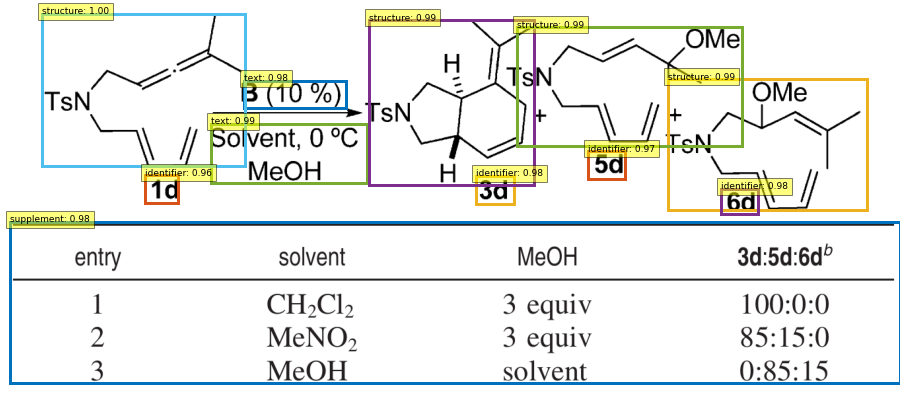

Image: ../../data/real-data/annotations/part1/train2017/ja206047h-Table-c3.png


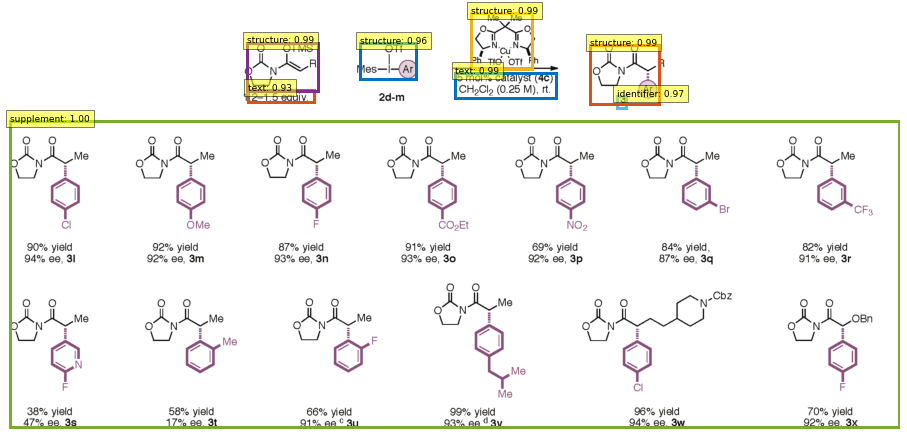

Image: ../../data/real-data/annotations/part1/train2017/ja511913h-Table-c2.png


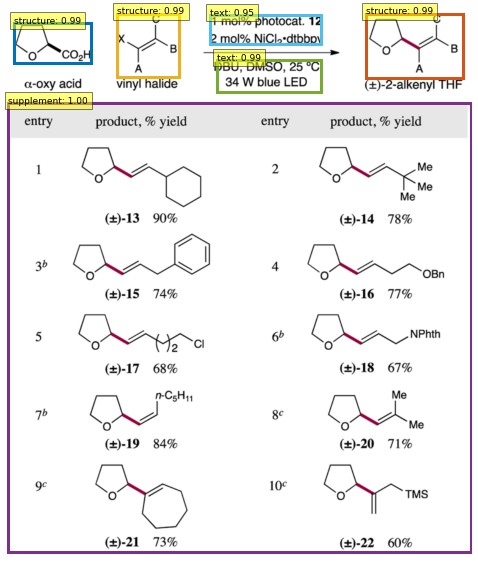

Image: ../../data/real-data/annotations/part1/train2017/ja3058138-Table-c1.png


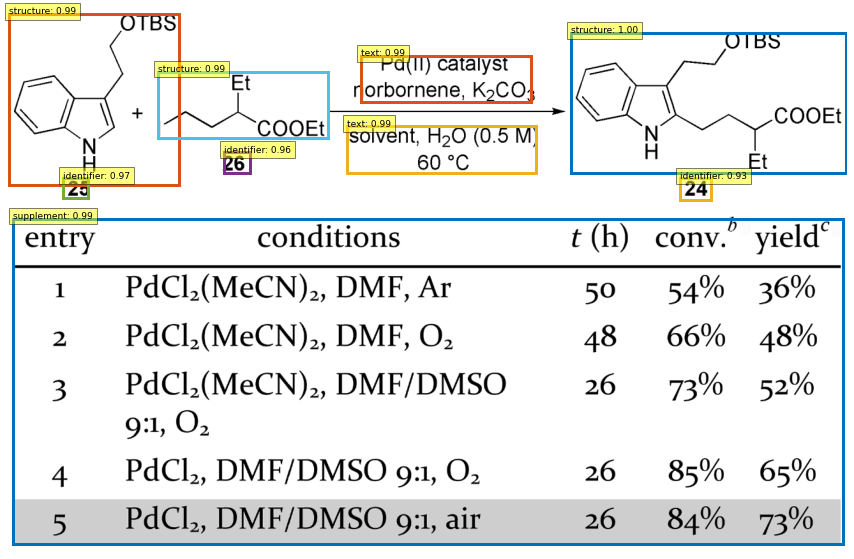

Image: ../../data/real-data/annotations/part1/train2017/ja5017206-Table-c2.png


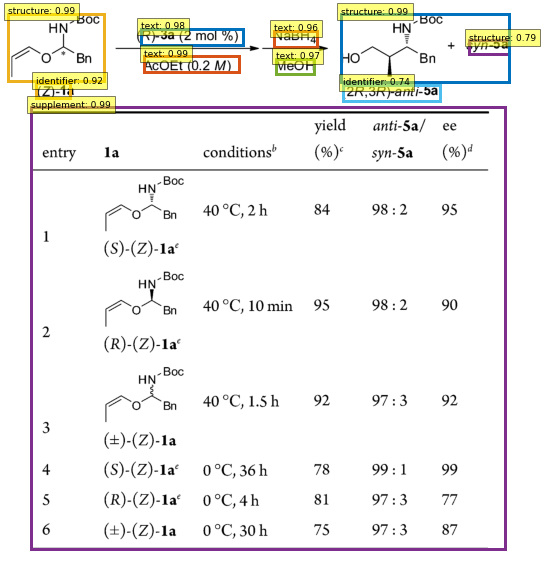

Image: ../../data/real-data/annotations/part1/train2017/ja042849b-Table-c1.png


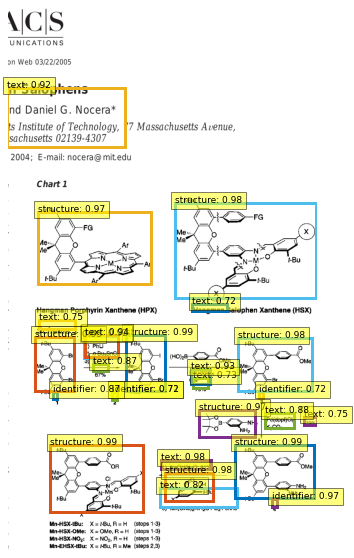

Image: ../../data/real-data/annotations/part1/train2017/ja960062i-Figure-c1.png


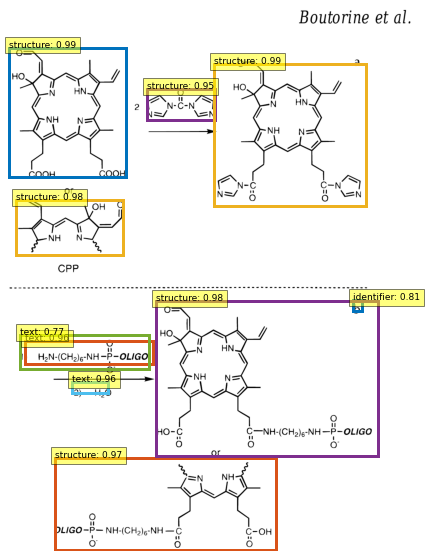

Image: ../../data/real-data/annotations/part1/train2017/ja5017206-Table-c3.png


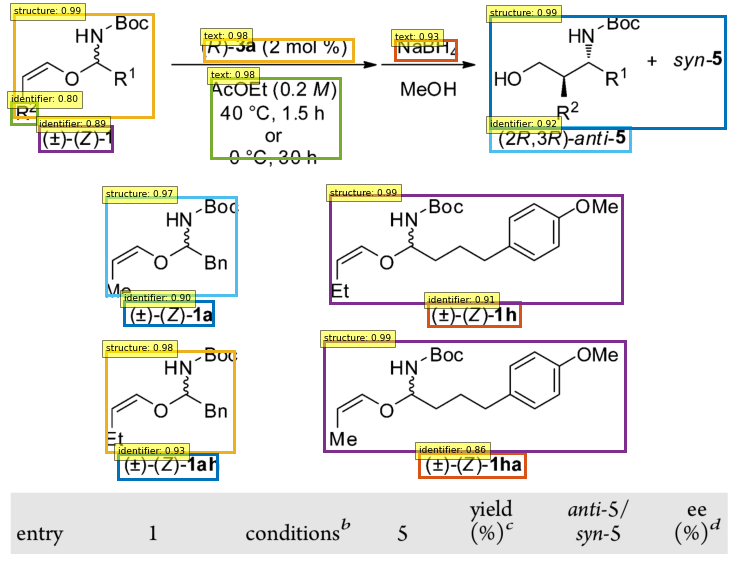

Image: ../../data/real-data/annotations/part1/train2017/ja307151x-Figure-c1.png


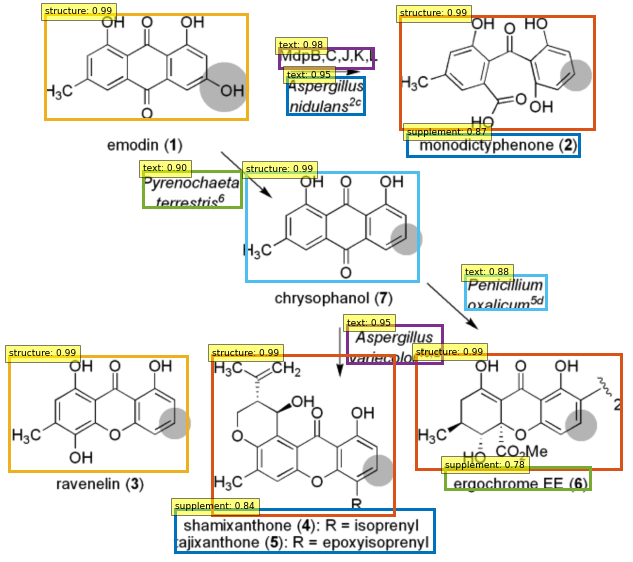

Image: ../../data/real-data/annotations/part1/train2017/jacs.5b05415-Figure-c5.png


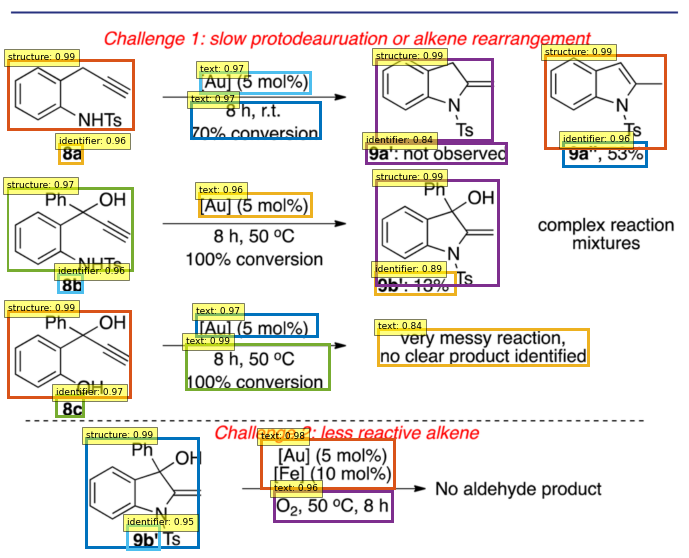

Image: ../../data/real-data/annotations/part1/train2017/ja1048847-Table-c3.png


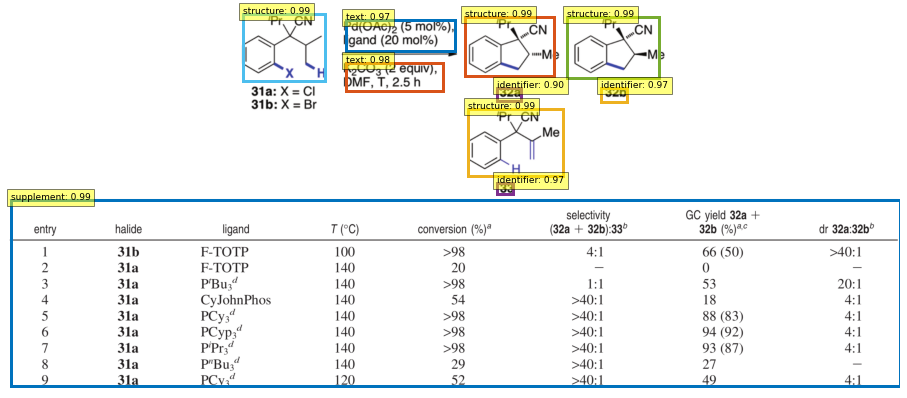

Image: ../../data/real-data/annotations/part1/train2017/ja960062i-Figure-c4.png


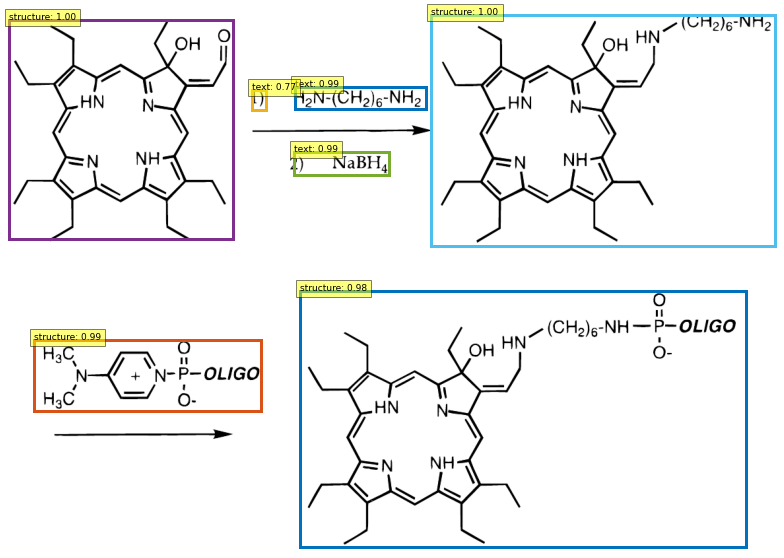

Image: ../../data/real-data/annotations/part1/train2017/ja312277g-Table-c4.png


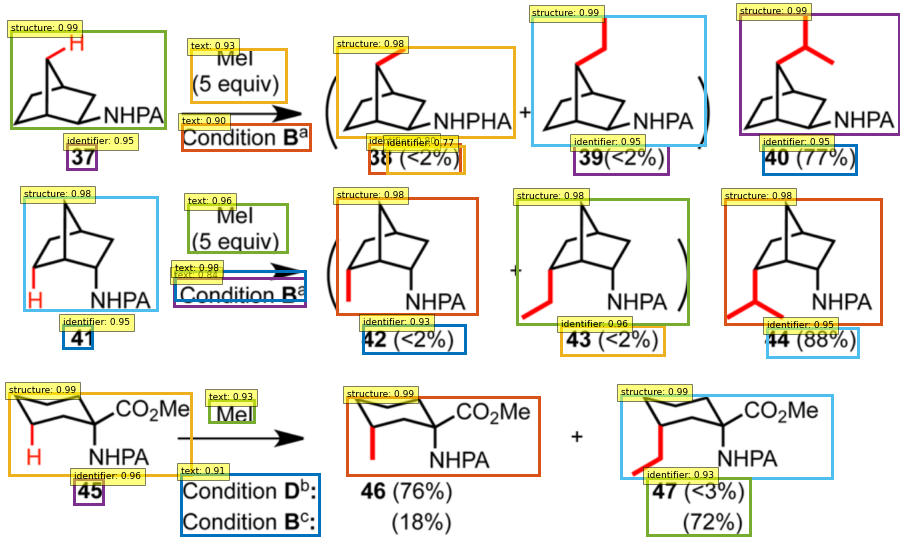

Image: ../../data/real-data/annotations/part1/train2017/ja9612413-Table-c3.png


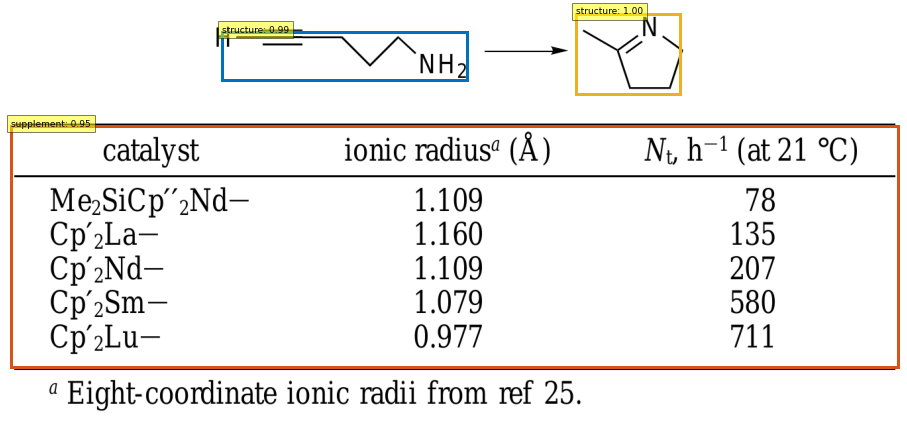

Image: ../../data/real-data/annotations/part1/train2017/ja206047h-Table-c2.png


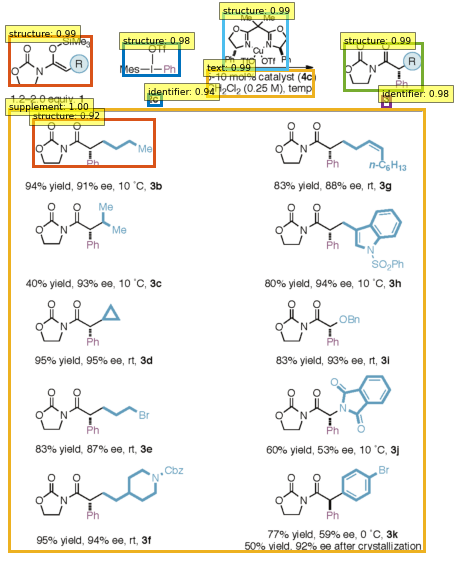

Image: ../../data/real-data/annotations/part1/train2017/ja9810742-Table-c2.png


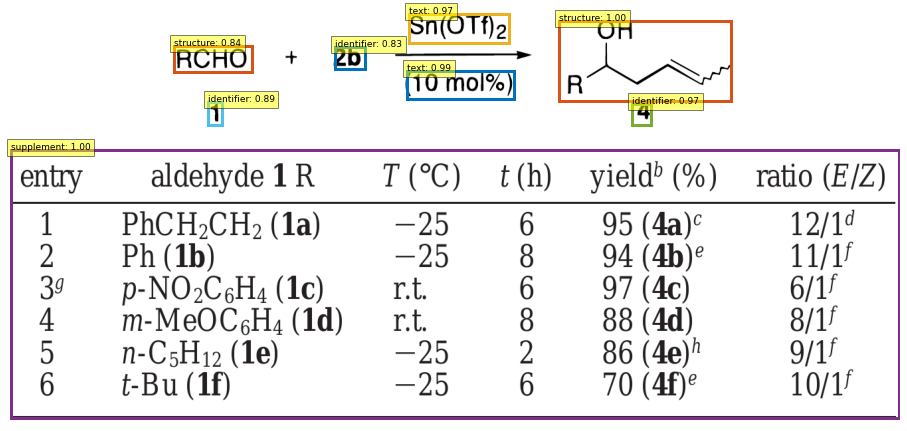

Image: ../../data/real-data/annotations/part1/train2017/ja408733f-Figure-c1.png


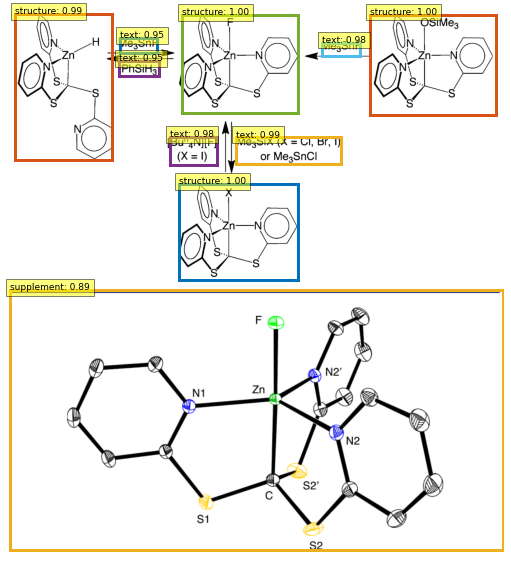

Image: ../../data/real-data/annotations/part1/train2017/jacs.6b00143-Table-c2.png


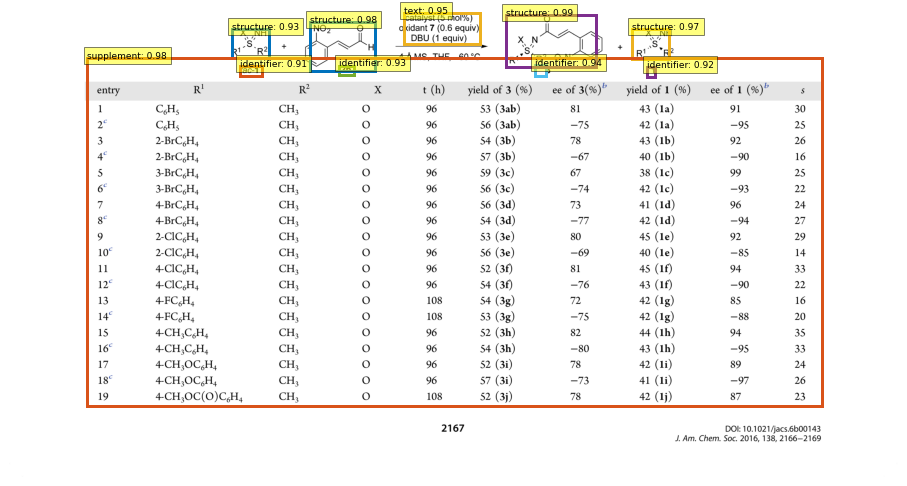

Image: ../../data/real-data/annotations/part1/train2017/ja406383h-Figure-c1.png


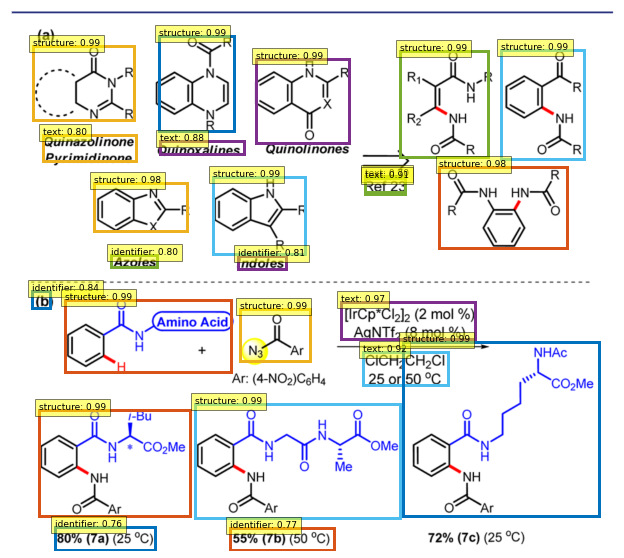

Image: ../../data/real-data/annotations/part1/train2017/ja905415r-Table-c1.png


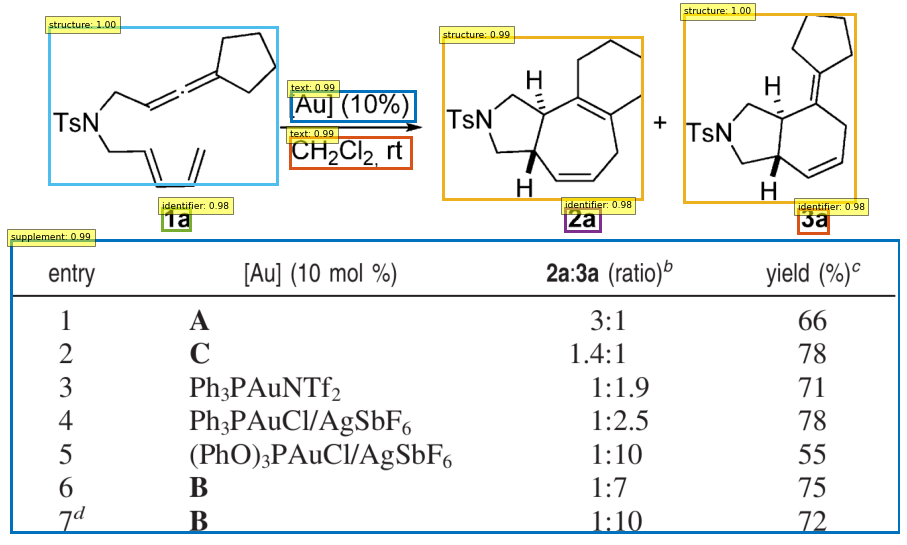

Image: ../../data/real-data/annotations/part1/train2017/jacs.5b12989-Table-c2.png


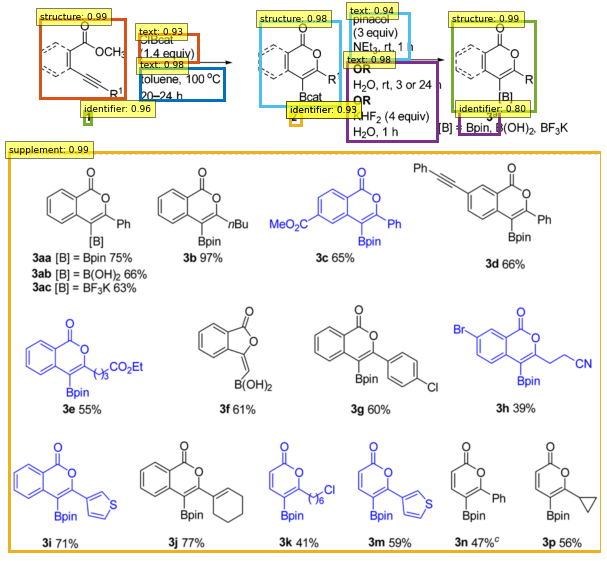

Image: ../../data/real-data/annotations/part1/train2017/ja0289088-Table-c2.png


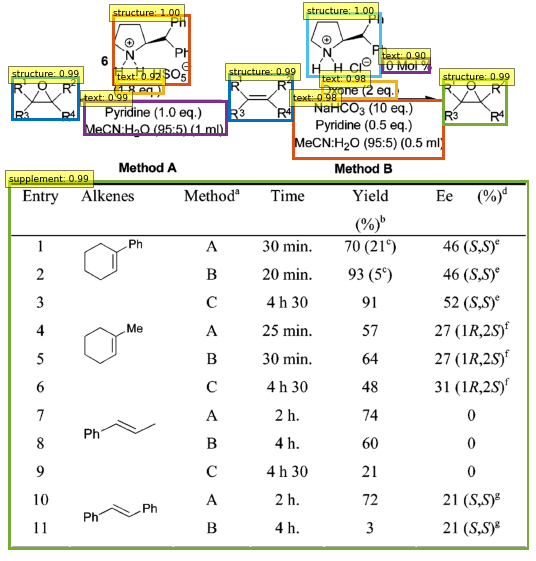

Image: ../../data/real-data/annotations/part1/train2017/ja9039289-Table-c1.png


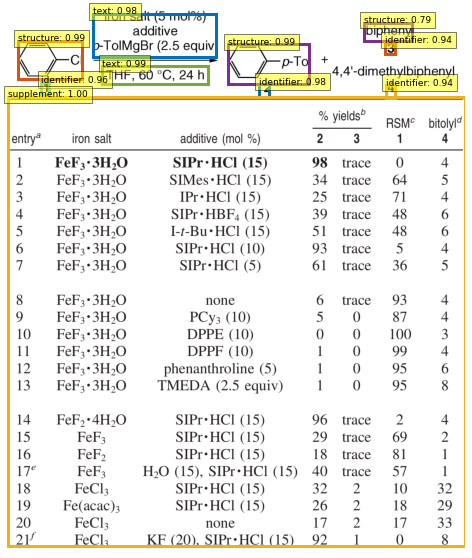

Image: ../../data/real-data/annotations/part1/train2017/ja905415r-Table-c5.png


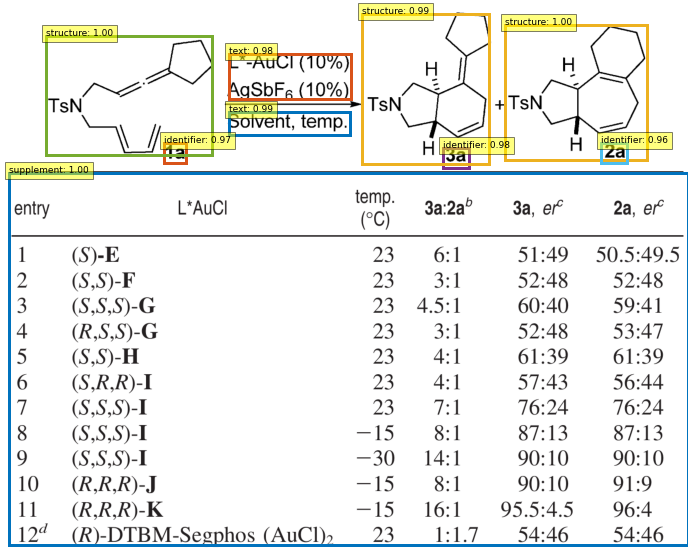

Image: ../../data/real-data/annotations/part1/train2017/ja501560x-Table-c1.png


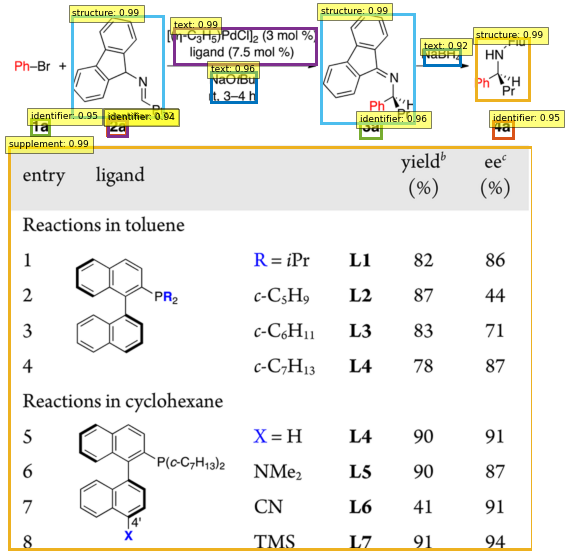

Image: ../../data/real-data/annotations/part1/train2017/ja410533y-Table-c3.png


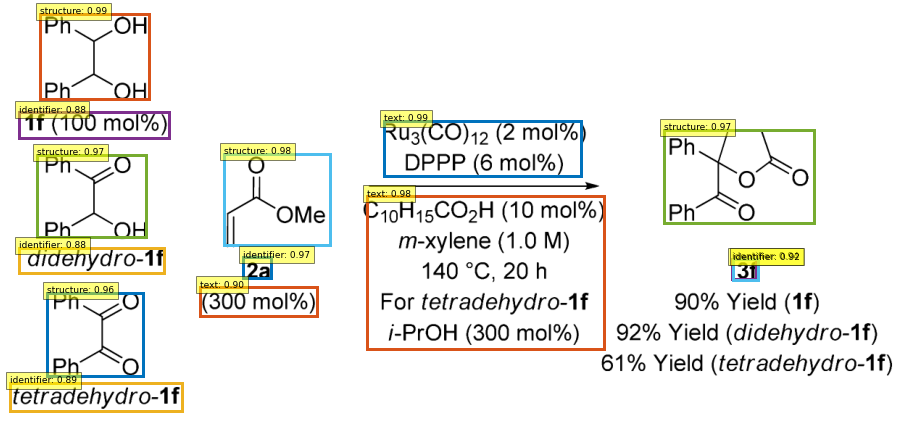

Image: ../../data/real-data/annotations/part1/train2017/jacs.5b05415-Figure-c2.png


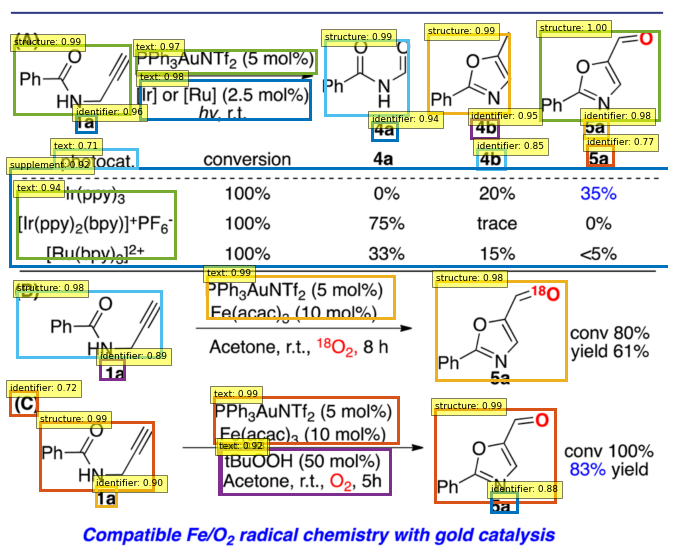

Image: ../../data/real-data/annotations/part1/train2017/ja905415r-Table-c3.png


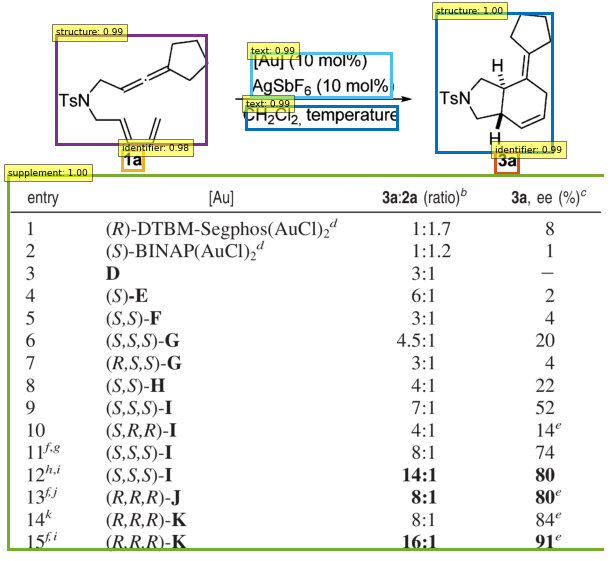

Image: ../../data/real-data/annotations/part1/train2017/ja960062i-Figure-c2.png


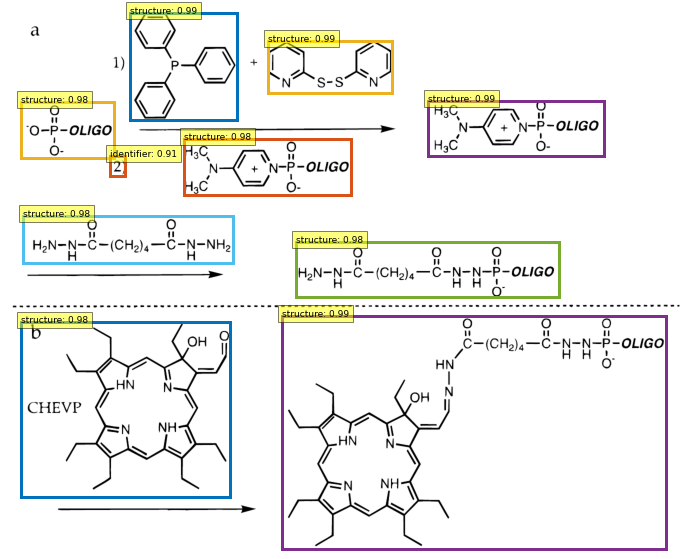

Image: ../../data/real-data/annotations/part1/train2017/ja053368a-Table-c1.png


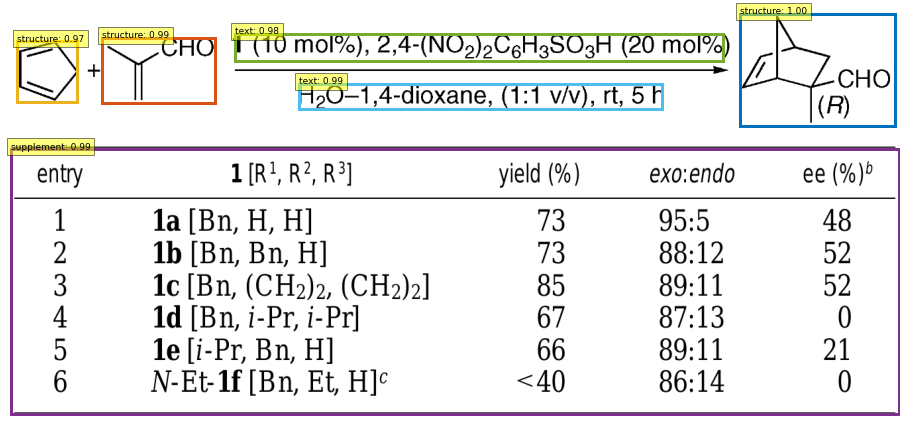

Image: ../../data/real-data/annotations/part1/train2017/ja953272o-Figure-c9.png


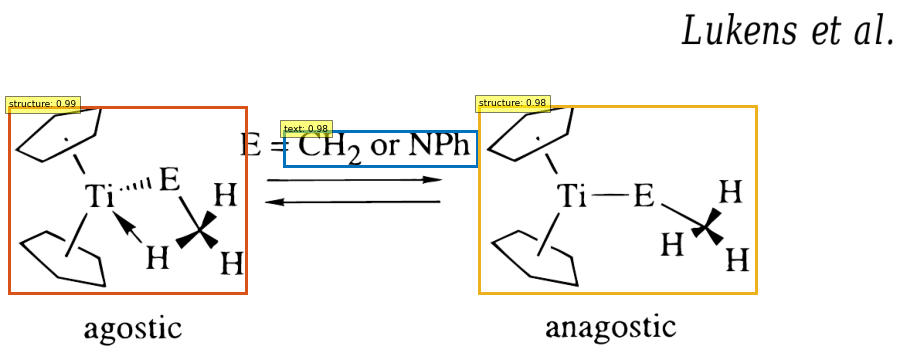

Image: ../../data/real-data/annotations/part1/train2017/ja053368a-Table-c2.png


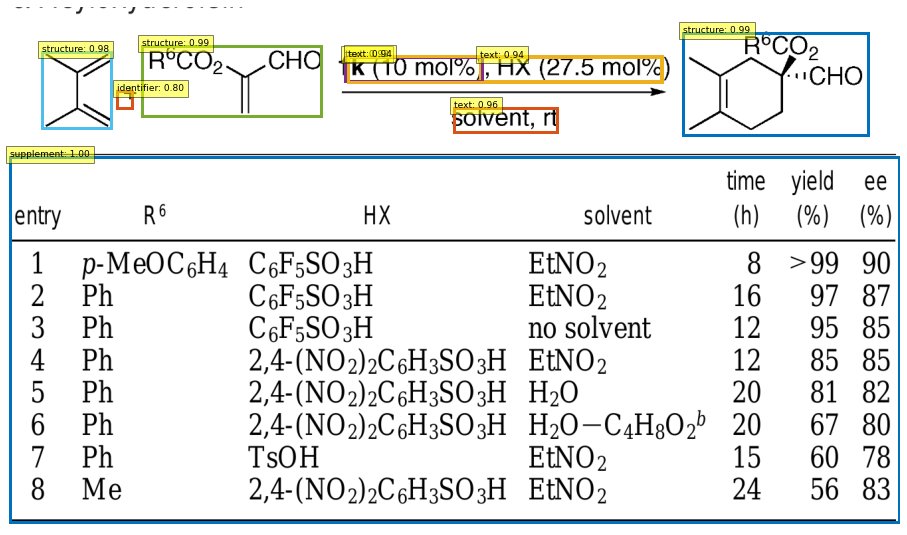

Image: ../../data/real-data/annotations/part1/train2017/ja5017206-Figure-c1.png


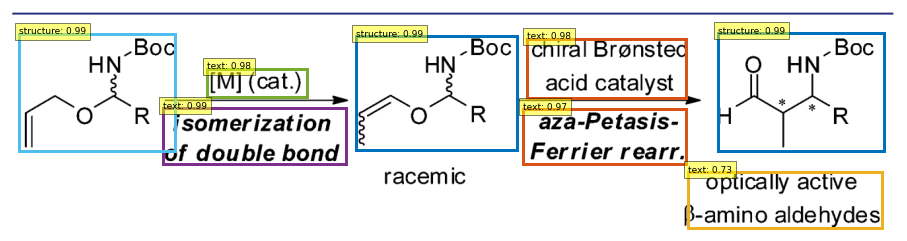

Image: ../../data/real-data/annotations/part1/train2017/ja001164i-Table-c3.png


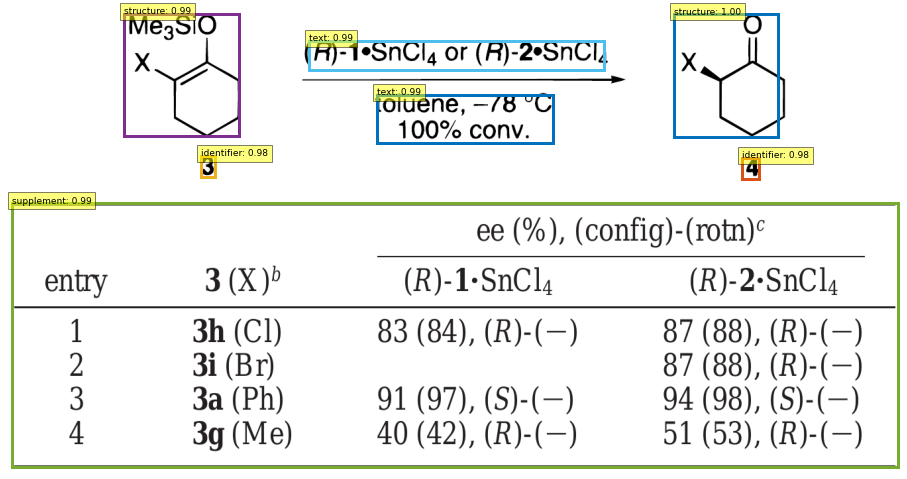

In [85]:
train_coco = COCO("../../data/real-data/annotations/part1/annotations/instances_train2017.json")
imgs = train_coco.imgs

for _, img_name in imgs.items():
    img_path = os.path.join('../../data/real-data/annotations/part1/train2017', img_name['file_name'])
    im = Image.open(img_path)
    print(f"Image: {img_path}")
    run_worflow(im, model)

## Results of DETR_DC5 (seems not as good as DETR qualitively)

In [98]:
detr_log = "./outputs/log.txt"
detr_dc5_log = "./outputs_dc5/log.txt"

import json
def get_ap(filepath):
    aps = []
    with open(filepath, "r") as f:
        for rec in f:
            obj = json.loads(rec.rstrip())
            aps.append(obj["test_coco_eval_bbox"][1])
    return aps

In [99]:
detr_aps = get_ap(detr_log)
detr_dc5_log = get_ap(detr_dc5_log)

In [103]:
print("\n".join(f"{x:.4f}, {y:.4f}" for x, y in list(zip(detr_aps, detr_dc5_log))))

0.0216, 0.0038
0.1107, 0.0527
0.1958, 0.2021
0.2410, 0.3006
0.3301, 0.3160
0.3593, 0.3604
0.3770, 0.4202
0.3711, 0.4433
0.3976, 0.4163
0.4327, 0.4304
0.4656, 0.3744
0.4667, 0.4870
0.4182, 0.4525
0.4935, 0.4604
0.5098, 0.4972
0.4912, 0.4437
0.5142, 0.4874
0.5312, 0.5067
0.5129, 0.4986
0.5064, 0.5096
0.4858, 0.4990
0.4661, 0.4639
0.5198, 0.4845
0.5393, 0.5699
0.4775, 0.4804
0.5305, 0.5035
0.4982, 0.5556
0.5596, 0.5089
0.5499, 0.4988
0.5099, 0.5058
0.5324, 0.5020
0.5389, 0.5227
0.4878, 0.4900
0.5518, 0.5438
0.5431, 0.5080
0.5654, 0.4756
0.5126, 0.5143
0.5706, 0.5329
0.5628, 0.5301
0.5665, 0.4669
0.5467, 0.5347
0.5822, 0.5137
0.5380, 0.5406
0.5767, 0.5539
0.5059, 0.5620
0.5562, 0.5122
0.5463, 0.5535
0.4888, 0.5400
0.5426, 0.5305
0.5415, 0.5837


In [104]:
import torch

model = torch.hub.load('facebookresearch/detr',
                       'detr_resnet50',
                       pretrained=False,
                       num_classes=6)

checkpoint = torch.load('outputs_dc5/checkpoint.pth',
                        map_location='cpu')

model.load_state_dict(checkpoint['model'],
                      strict=False)

model.eval()
model.to('cuda')

Using cache found in /data/scratch/jiang_guo/cache/Torch/hub/facebookresearch_detr_master


DETR(
  (transformer): Transformer(
    (encoder): TransformerEncoder(
      (layers): ModuleList(
        (0): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): _LinearWithBias(in_features=256, out_features=256, bias=True)
          )
          (linear1): Linear(in_features=256, out_features=2048, bias=True)
          (dropout): Dropout(p=0.1, inplace=False)
          (linear2): Linear(in_features=2048, out_features=256, bias=True)
          (norm1): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (norm2): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
          (dropout1): Dropout(p=0.1, inplace=False)
          (dropout2): Dropout(p=0.1, inplace=False)
        )
        (1): TransformerEncoderLayer(
          (self_attn): MultiheadAttention(
            (out_proj): _LinearWithBias(in_features=256, out_features=256, bias=True)
          )
          (linear1): Linear(in_features=256, out_features=2048, bias=True)
       

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Image: ../../data/real-data/annotations/part1/val2017/ja208286b-Figure-c1.png


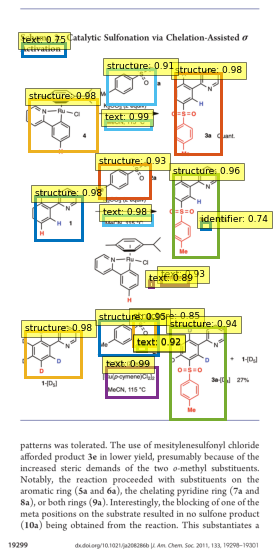

Image: ../../data/real-data/annotations/part1/val2017/ja9039289-Table-c3.png


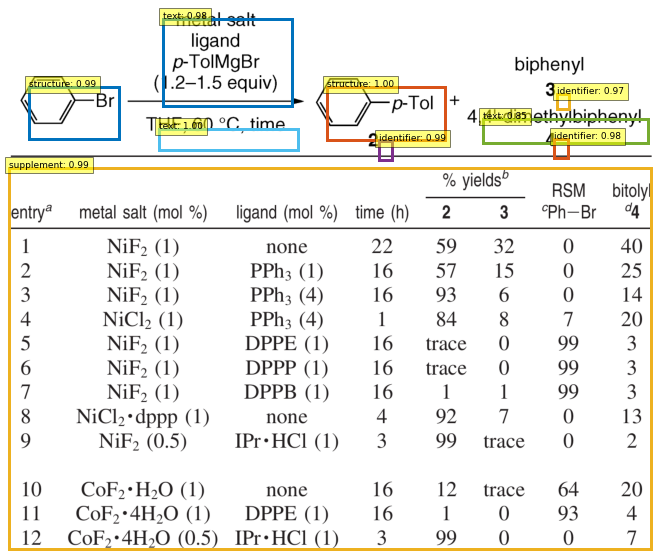

Image: ../../data/real-data/annotations/part1/val2017/ja511335v-Table-c1.png


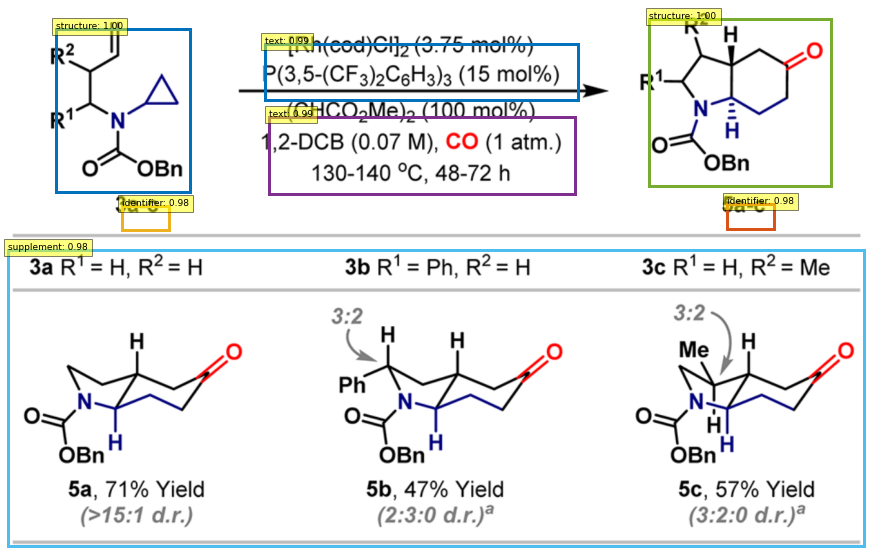

Image: ../../data/real-data/annotations/part1/val2017/ja406383h-Table-c1.png


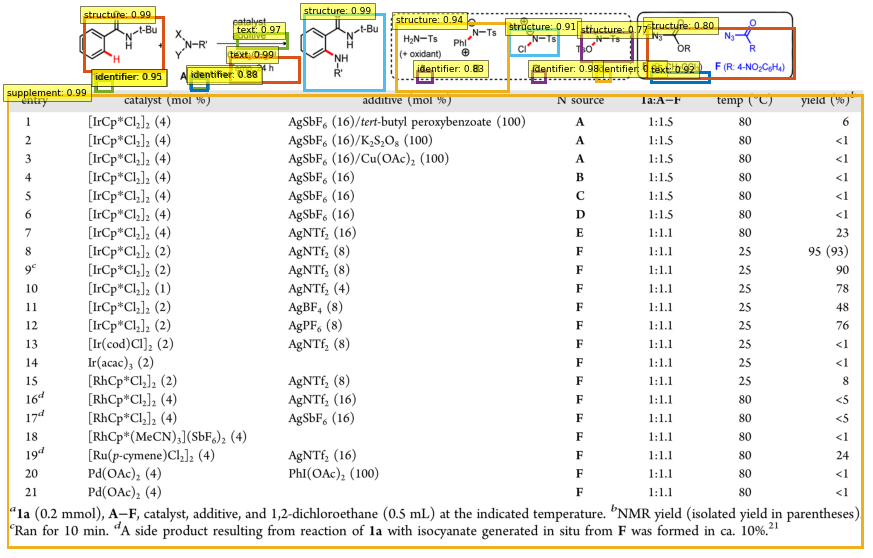

Image: ../../data/real-data/annotations/part1/val2017/ja408031s-Table-c1.png


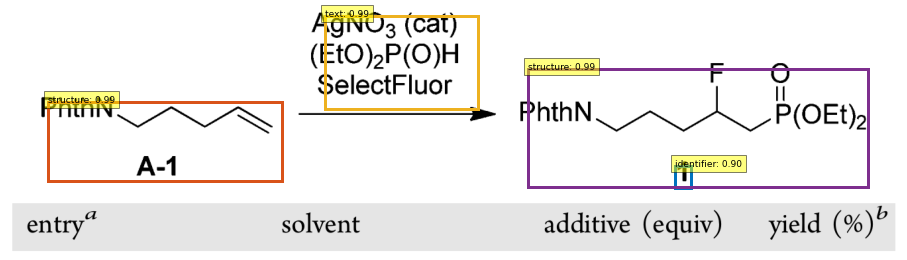

Image: ../../data/real-data/annotations/part1/val2017/ja0289088-Table-c1.png


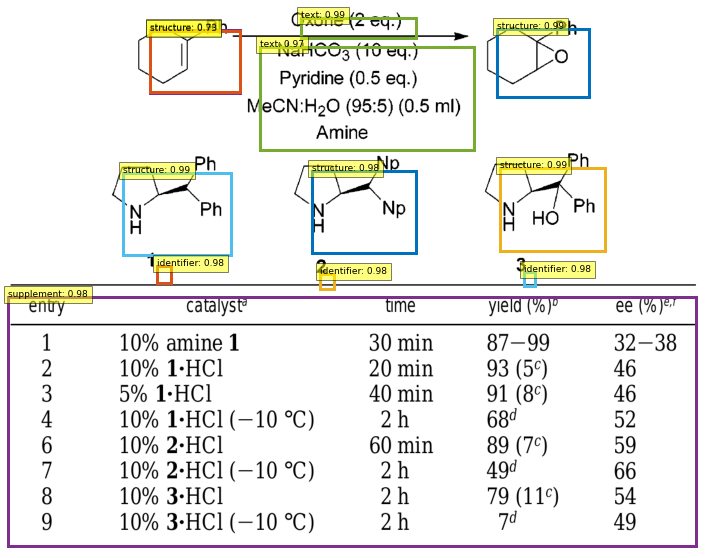

Image: ../../data/real-data/annotations/part1/val2017/ja200818w-Table-c1.png


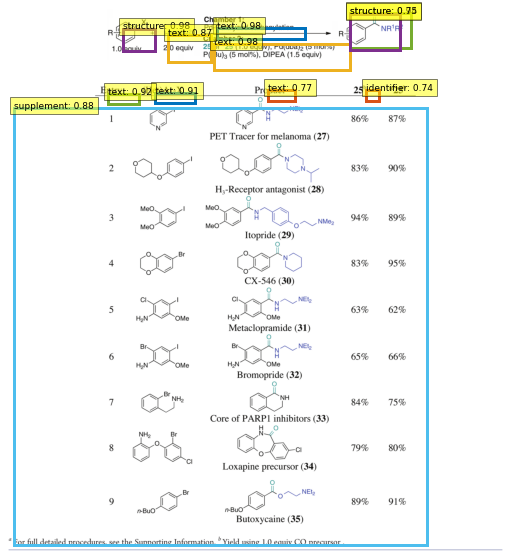

Image: ../../data/real-data/annotations/part1/val2017/ja511913h-Table-c1.png


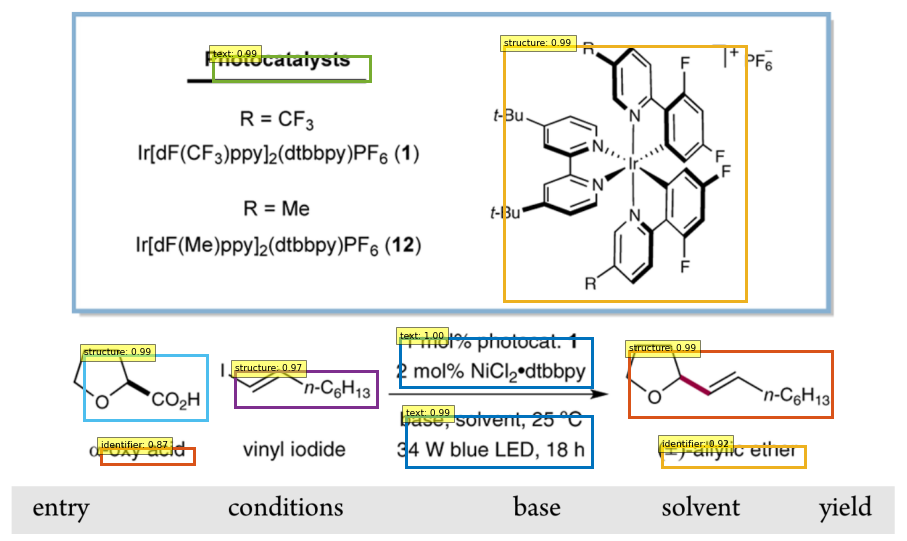

Image: ../../data/real-data/annotations/part1/val2017/ja208286b-Table-c1.png


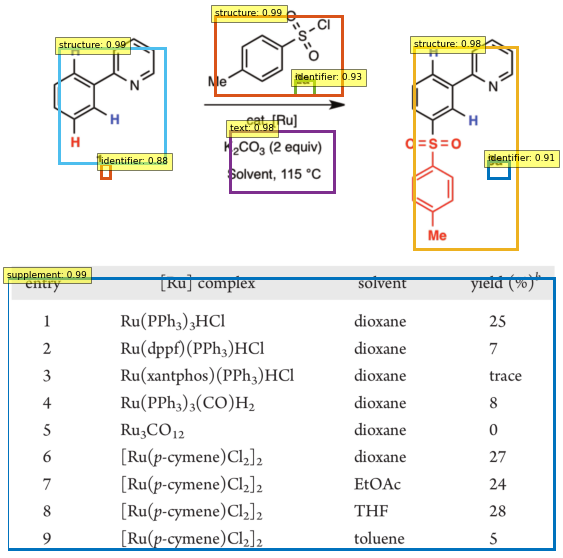

Image: ../../data/real-data/annotations/part1/val2017/ja3066978-Table-c1.png


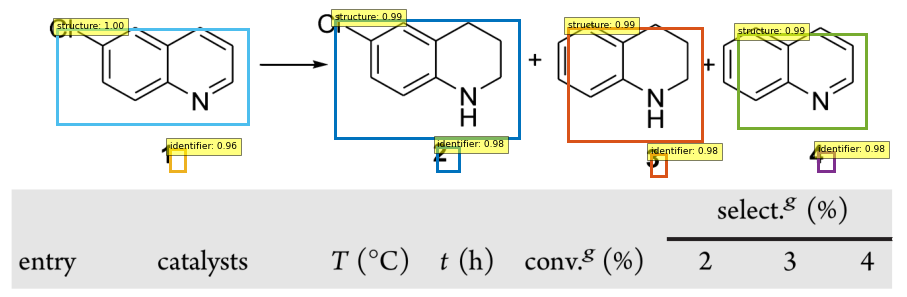

Image: ../../data/real-data/annotations/part1/val2017/ja9039289-Table-c2.png


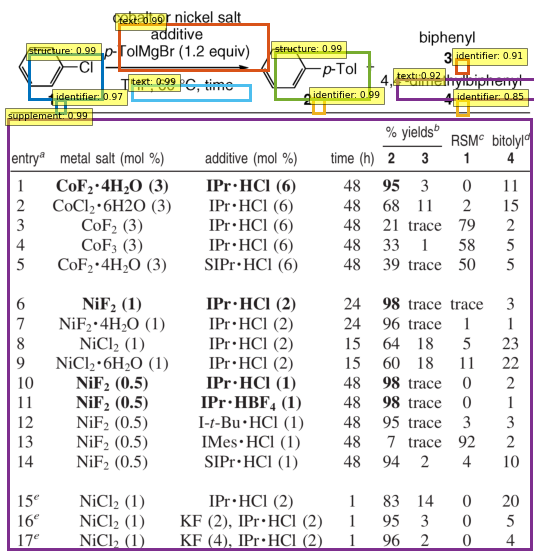

Image: ../../data/real-data/annotations/part1/val2017/ja406383h-Table-c2.png


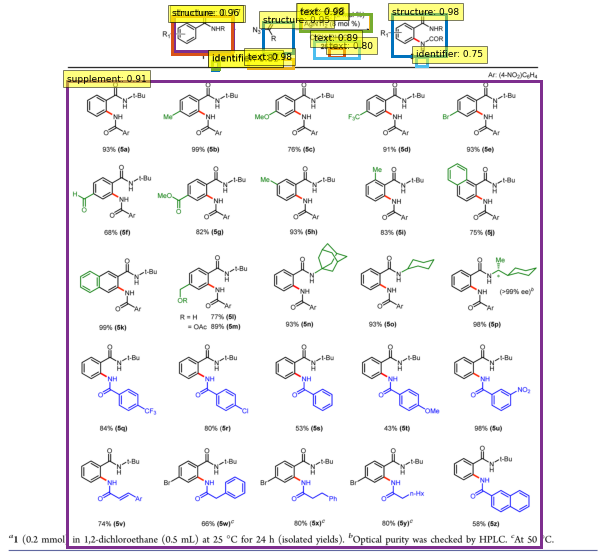

In [105]:
val_coco = COCO("../../data/real-data/annotations/part1/annotations/instances_val2017.json")
imgs = val_coco.imgs

for _, img_name in imgs.items():
    img_path = os.path.join('../../data/real-data/annotations/part1/val2017', img_name['file_name'])
    im = Image.open(img_path)
    print(f"Image: {img_path}")
    run_worflow(im, model)